In [11]:
import os
print(f"Current working directory: {os.getcwd()}")

Current working directory: /Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui


## example code for single subject (features from muse) synchronized with time log file

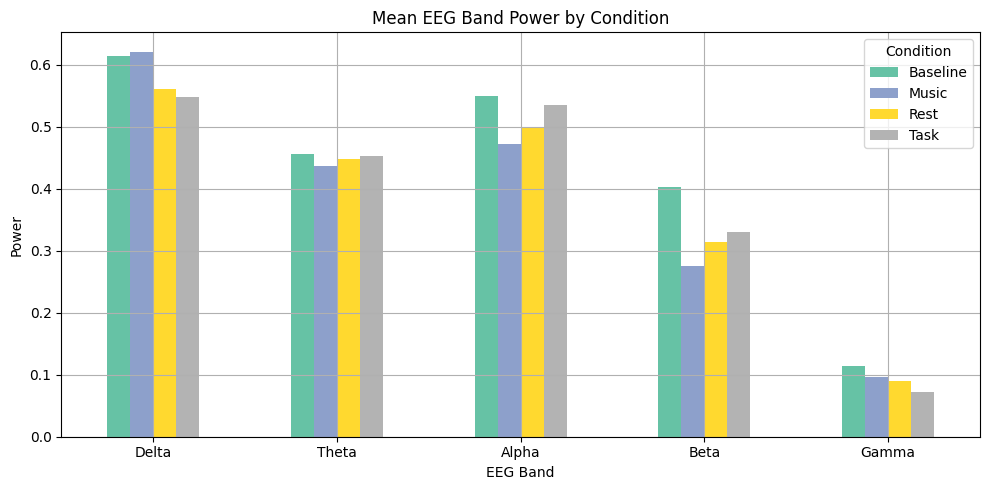

In [12]:
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import os

# === Load EEG data ===
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
df = pd.read_csv(eeg_file)
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# === Load sync log file ===
log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/eeg_experiment_timeline_log_10.txt"
sync_df = pd.read_csv(log_file, sep='\t', header=None, names=["Event", "Time"])
sync_df = sync_df.dropna()

# === Extract experiment start time and fix offset ===
exp_start_event = sync_df[sync_df["Event"].str.contains("Experiment Unix Start")]
experiment_unix_start = float(exp_start_event["Time"].values[0]) + 2 * 3600  # Adjust 2-hour offset

# === Compute absolute timestamps for task/rest intervals ===
task_intervals, rest_intervals = [], []
for i in range(len(sync_df) - 1):
    event = sync_df.iloc[i]["Event"]
    time_offset = sync_df.iloc[i]["Time"]
    abs_time = pd.to_datetime(experiment_unix_start + time_offset, unit="s")

    if "Task Start" in event:
        task_start = abs_time
        task_end = pd.to_datetime(experiment_unix_start + sync_df.iloc[i + 1]["Time"], unit="s")
        task_intervals.append((task_start, task_end))

    if "Rest Start" in event:
        rest_start = abs_time
        rest_end = pd.to_datetime(experiment_unix_start + sync_df.iloc[i + 1]["Time"], unit="s")
        rest_intervals.append((rest_start, rest_end))

# === Compute average EEG band power across channels ===
bands = ["Delta", "Theta", "Alpha", "Beta", "Gamma"]
channels = ["TP9", "AF7", "AF8", "TP10"]
band_cols = [f"{band}_{ch}" for band in bands for ch in channels if f"{band}_{ch}" in df.columns]

df_band_avg = df[band_cols].copy()
for band in bands:
    cols = [f"{band}_{ch}" for ch in channels if f"{band}_{ch}" in df_band_avg.columns]
    df_band_avg[band] = df_band_avg[cols].mean(axis=1).abs()

# === Label all time windows: Baseline, Task, Rest, Music ===
df_band_avg["Condition"] = "Unlabeled"

# Baseline
baseline_start = pd.to_datetime(experiment_unix_start + sync_df[sync_df["Event"] == "Baseline Start"]["Time"].values[0], unit="s")
baseline_end = pd.to_datetime(experiment_unix_start + sync_df[sync_df["Event"] == "Baseline End"]["Time"].values[0], unit="s")
df_band_avg.loc[(df_band_avg.index >= baseline_start) & (df_band_avg.index <= baseline_end), "Condition"] = "Baseline"

# Task and Rest
for start, end in task_intervals:
    df_band_avg.loc[(df_band_avg.index >= start) & (df_band_avg.index <= end), "Condition"] = "Task"

for start, end in rest_intervals:
    df_band_avg.loc[(df_band_avg.index >= start) & (df_band_avg.index <= end), "Condition"] = "Rest"

# Music
if "Music Start" in sync_df["Event"].values and "Music End" in sync_df["Event"].values:
    music_start = pd.to_datetime(experiment_unix_start + sync_df[sync_df["Event"] == "Music Start"]["Time"].values[0], unit="s")
    music_end = pd.to_datetime(experiment_unix_start + sync_df[sync_df["Event"] == "Music End"]["Time"].values[0], unit="s")
    df_band_avg.loc[(df_band_avg.index >= music_start) & (df_band_avg.index <= music_end), "Condition"] = "Music"

# Remove any remaining unlabeled data
df_band_avg = df_band_avg[df_band_avg["Condition"] != "Unlabeled"]

# === Plot mean EEG band power by condition ===
summary = df_band_avg.groupby("Condition")[bands].mean()
summary.T.plot(kind="bar", colormap="Set2", figsize=(10, 5))
plt.title("Mean EEG Band Power by Condition")
plt.ylabel("Power")
plt.xlabel("EEG Band")
plt.xticks(rotation=0)
plt.grid(True)
plt.tight_layout()
plt.show()


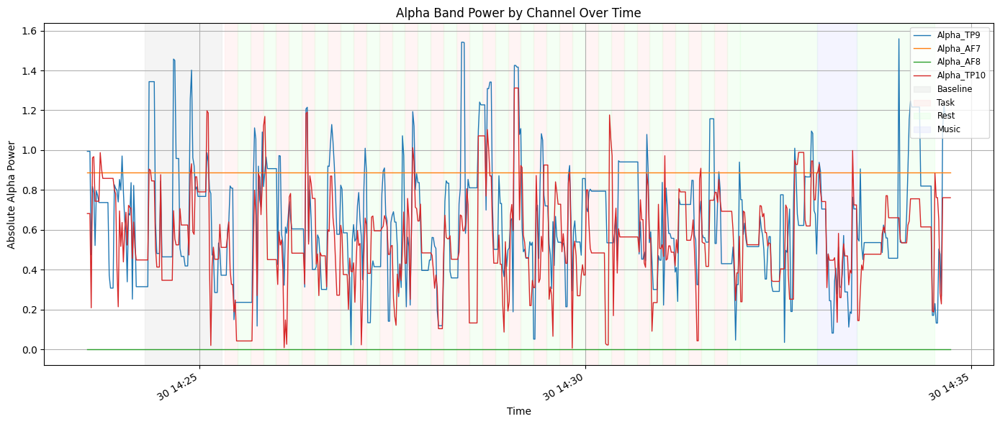

In [26]:
import pandas as pd
import matplotlib.pyplot as plt

# === File paths ===
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/eeg_experiment_timeline_log_10.txt"

# === 1) Load EEG data ===
df = pd.read_csv(eeg_file)

# --- Drop any Muse “event” rows so they don’t sneak into our band-power time series ---
# these rows will have a timestamp and an Elements string, but no numeric data
if "Elements" in df.columns:
    df = df[df["Elements"].isna()]

# parse timestamps and set index
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# === 2) Load sync log and compute experiment start ===
sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event", "Time"])
sync_df.dropna(inplace=True)
exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
experiment_unix_start = exp0 + 2 * 3600  # apply your 2h offset
to_ts = lambda offset: pd.to_datetime(experiment_unix_start + offset, unit="s")

# === 3) Build condition intervals ===
intervals = {"Baseline": [], "Task": [], "Rest": [], "Music": []}
# Baseline
b0 = float(sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0])
b1 = float(sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0])
intervals["Baseline"].append((to_ts(b0), to_ts(b1)))
# Task & Rest
for i, row in sync_df.iterrows():
    ev, t0 = row["Event"], float(row["Time"])
    if "Task Start" in ev:
        t1 = float(sync_df.at[i+1, "Time"])
        intervals["Task"].append((to_ts(t0), to_ts(t1)))
    if "Rest Start" in ev:
        t1 = float(sync_df.at[i+1, "Time"])
        intervals["Rest"].append((to_ts(t0), to_ts(t1)))
# Music (if present)
if "Music Start" in sync_df["Event"].values:
    m0 = float(sync_df.loc[sync_df["Event"]=="Music Start", "Time"].iat[0])
    m1 = float(sync_df.loc[sync_df["Event"]=="Music End",   "Time"].iat[0])
    intervals["Music"].append((to_ts(m0), to_ts(m1)))

# === 4) Plot each Alpha channel separately ===
alpha_cols = [c for c in df.columns if c.startswith("Alpha_")]

fig, ax = plt.subplots(figsize=(14, 6))

# plot each channel
for ch in alpha_cols:
    ax.plot(df.index, df[ch].abs(), label=ch, linewidth=1)

# background shading
colors = {
    "Baseline": "#DDDDDD",
    "Task":     "#FFDDDD",
    "Rest":     "#DDFFDD",
    "Music":    "#DDDDFF",
}
for cond, spans in intervals.items():
    for start, end in spans:
        ax.axvspan(start, end, color=colors[cond], alpha=0.3, label=cond)

# clean legend (no duplicate condition labels)
lines, labels = ax.get_legend_handles_labels()
seen = set()
ordered = []
for ln, lbl in zip(lines, labels):
    if lbl in seen:
        continue
    ordered.append((ln, lbl))
    seen.add(lbl)
ax.legend([ln for ln, _ in ordered], [lbl for _, lbl in ordered],
          loc="upper right", fontsize="small")

ax.set_title("Alpha Band Power by Channel Over Time")
ax.set_xlabel("Time")
ax.set_ylabel("Absolute Alpha Power")
ax.grid(True)
fig.autofmt_xdate()
plt.tight_layout()
plt.show()


In [39]:
import pandas as pd
import numpy as np

# === File paths ===
# === File paths ===
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/eeg_experiment_timeline_log_10.txt"

# === 1) Load & clean EEG data ===
df = pd.read_csv(eeg_file)

# drop any Muse “event” lines (blinks, jaw clenches, etc.)
if "Elements" in df.columns:
    df = df[df["Elements"].isna()]

# parse timestamps
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# === 2) Load sync log & build condition intervals ===
sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event", "Time"])
sync_df.dropna(inplace=True)

# find experiment unix start + your 2 h offset
exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
t0 = exp0 + 2 * 3600
to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

intervals = {"Baseline": [], "Task": [], "Rest": [], "Music": []}

# baseline
b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
intervals["Baseline"].append((to_ts(b0), to_ts(b1)))

# task & rest
for i, row in sync_df.iterrows():
    ev, offs = row["Event"], row["Time"]
    if "Task Start" in ev:
        intervals["Task"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))
    if "Rest Start" in ev:
        intervals["Rest"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))

# music (if present)
if "Music Start" in sync_df["Event"].values:
    m0 = sync_df.loc[sync_df["Event"]=="Music Start", "Time"].iat[0]
    m1 = sync_df.loc[sync_df["Event"]=="Music End",   "Time"].iat[0]
    intervals["Music"].append((to_ts(m0), to_ts(m1)))

# === 3) Label each row with its Condition ===
df["Condition"] = "Unlabeled"
for cond, spans in intervals.items():
    for start, end in spans:
        mask = (df.index >= start) & (df.index <= end)
        df.loc[mask, "Condition"] = cond

# drop any unlabeled samples
df = df[df["Condition"] != "Unlabeled"]

# === 4) Build arrays ===

# 4a) feature matrix: features × time
#    select all numeric columns (drops TimeStamp, Elements, Condition)
feature_cols = df.select_dtypes(include="number").columns.tolist()
X = df[feature_cols].T.values      # shape = (n_features, n_timesteps)

# 4b) labels per timepoint
y = df["Condition"].values         # shape = (n_timesteps,)

# 4c) actual timestamps
times = df.index.to_numpy()        # shape = (n_timesteps,)

# === 5) Save to disk ===
np.save("features.npy", X)
np.save("labels.npy",   y)
np.save("times.npy",    times)

print(f"Saved:\n - features.npy: {X.shape}\n - labels.npy:   {y.shape}\n - times.npy:    {times.shape}")


Saved:
 - features.npy: (41, 612)
 - labels.npy:   (612,)
 - times.npy:    (612,)


Viterbi decoding accuracy: 76.96%


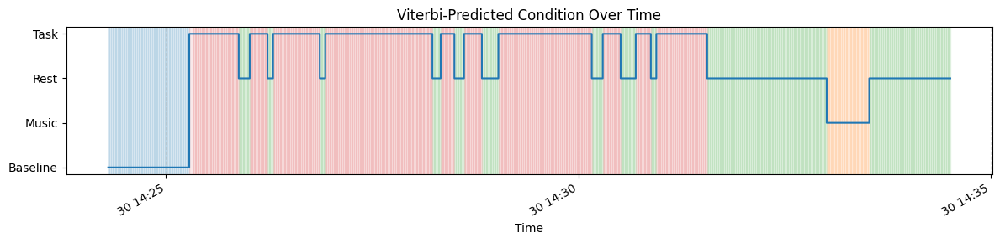

In [40]:
import numpy as np
import matplotlib.pyplot as plt
from hmmlearn import hmm
from collections import Counter
import itertools

# --- 1) Load your arrays (or replace these with your DataFrame extraction) ---
# X: np.ndarray, shape (n_features,  n_timesteps)
# y: np.ndarray, shape (n_timesteps,) of strings like "Baseline","Task",...
# times: np.ndarray, shape (n_timesteps,) of datetime64

X     = X
y_true = y      # (n_t,)
times = times              # (n_t,)

# --- 2) Encode states as integers ---
states = sorted(np.unique(y_true))
n_states = len(states)
state_to_idx = {s:i for i,s in enumerate(states)}
idx_to_state = {i:s for s,i in state_to_idx.items()}
y_idx = np.array([state_to_idx[s] for s in y_true])

# --- 3) Estimate π and A from the true labels ---
# initial distribution: 1 at the very first true state
pi = np.zeros(n_states)
pi[y_idx[0]] = 1.0

# transition matrix counts
A_counts = np.zeros((n_states, n_states))
for (i,j) in zip(y_idx[:-1], y_idx[1:]):
    A_counts[i,j] += 1
# normalize
A = (A_counts.T / A_counts.sum(axis=1)).T
# fix any rows that sum to zero
for i in range(n_states):
    if A[i].sum() == 0:
        A[i,i] = 1.0

# --- 4) Fit one Gaussian per state on its observations ---
# we'll fit full‐covariance Gaussians
means   = []
covars  = []
reg = 1e-2   # try 1e-2 or even 1e-1 if needed

for i in range(n_states):
    obs = X[:, y_idx == i].T
    mu = obs.mean(axis=0)
    # empirical covariance
    C = np.cov(obs, rowvar=False)
    # symmetrize
    C = 0.5 * (C + C.T)
    # add jitter
    C += reg * np.eye(C.shape[0])

    means.append(mu)
    covars.append(C)

means  = np.vstack(means)
covars = np.stack(covars)
# --- 5) Build and decode with the HMM ---
model = hmm.GaussianHMM(n_components=n_states,
                        covariance_type="full", 
                        init_params="")  
# we disable init_params so we can set our own π, A, means, covars
model.startprob_ = pi
model.transmat_  = A
model.means_     = means
model.covars_    = covars

# Viterbi decode (we need shape (n_t, n_features))
logprob, y_pred_idx = model.decode(X.T, algorithm="viterbi")
y_pred = np.array([idx_to_state[i] for i in y_pred_idx])

# --- 6) Compute accuracy ---
accuracy = (y_pred == y_true).mean()
print(f"Viterbi decoding accuracy: {accuracy*100:.2f}%")

# --- 7) Plot predicted state over time ---
# assign each state a y‐value and color
state_y     = {s:i for i,s in enumerate(states)}
state_color = dict(zip(states, plt.rcParams["axes.prop_cycle"].by_key()["color"][:n_states]))

y_pred_y = [state_y[s] for s in y_pred]

fig, ax = plt.subplots(figsize=(12,3))
ax.step(times, y_pred_y, where="post", lw=1.5)
ax.set_yticks(list(state_y.values()))
ax.set_yticklabels(states)
ax.set_xlabel("Time")
ax.set_title("Viterbi‐Predicted Condition Over Time")
ax.grid(axis="x", linestyle="--", alpha=0.4)

# shade background by predicted state
for i, (t0, t1) in enumerate(zip(times[:-1], times[1:])):
    c = state_color[y_pred[i]]
    ax.axvspan(t0, t1, color=c, alpha=0.1)

fig.autofmt_xdate()
plt.tight_layout()
plt.show()


Decoding accuracy: 77.0%


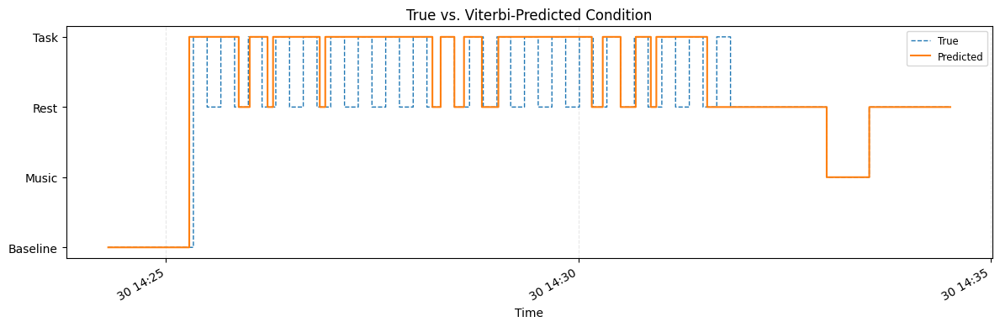

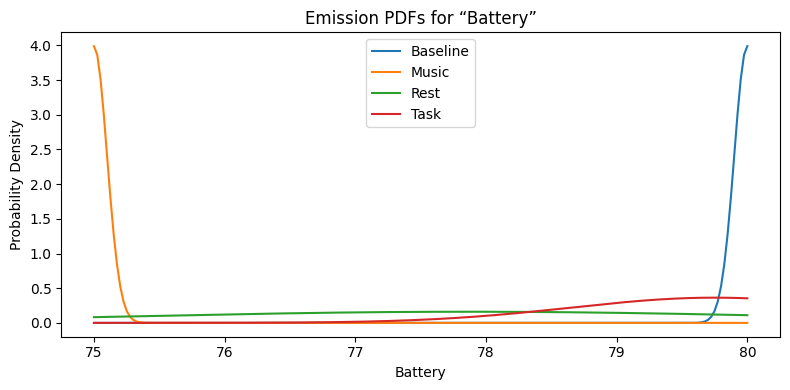

In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm


X     = X
y_true = y      # (n_t,)
times = times              # (n_t,)

# --- 2) (Re)load feature names so we can label the PDF plot ---
# adjust this path to your actual CSV
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
df_full   = pd.read_csv(eeg_file)
if "Elements" in df_full.columns:
    df_full = df_full[df_full["Elements"].isna()]
df_full["Time"] = pd.to_datetime(df_full["TimeStamp"])
df_full.set_index("Time", inplace=True)
feature_cols = df_full.select_dtypes(include="number").columns.tolist()

# --- 3) Re‐run the HMM setup & Viterbi (as before) ---
states     = sorted(np.unique(y_true))
n_states   = len(states)
state2idx  = {s:i for i,s in enumerate(states)}
idx2state  = {i:s for s,i in state2idx.items()}
y_idx      = np.array([state2idx[s] for s in y_true])

# initial π
pi = np.zeros(n_states); pi[y_idx[0]] = 1.0

# transition counts→matrix
A_counts = np.zeros((n_states,n_states))
for i,j in zip(y_idx[:-1], y_idx[1:]):
    A_counts[i,j] += 1
A = (A_counts.T / A_counts.sum(axis=1)).T
for i in range(n_states):
    if A[i].sum()==0: A[i,i]=1.0

# fit one Gaussian per state
means, covars = [], []
reg = 1e-2
for i in range(n_states):
    obs = X[:, y_idx==i].T
    mu  = obs.mean(0)
    C   = np.cov(obs, rowvar=False)
    C   = 0.5*(C + C.T) + reg*np.eye(C.shape[0])
    means.append(mu); covars.append(C)
means  = np.vstack(means)
covars = np.stack(covars)

# build HMM & decode
model = hmm.GaussianHMM(n_components=n_states, covariance_type="full", init_params="")
model.startprob_ = pi
model.transmat_  = A
model.means_     = means
model.covars_    = covars

_, y_pred_idx = model.decode(X.T, algorithm="viterbi")
y_pred = np.array([idx2state[i] for i in y_pred_idx])

# accuracy
acc = (y_pred==y_true).mean()
print(f"Decoding accuracy: {acc*100:.1f}%")

# --- 4) Plot true vs predicted states over time ---
state2y = {s:i for i,s in enumerate(states)}
y_true_int = [state2y[s] for s in y_true]
y_pred_int = [state2y[s] for s in y_pred]

fig, ax = plt.subplots(figsize=(12,4))
ax.step(times, y_true_int, where="post", linestyle="--", label="True",   lw=1)
ax.step(times, y_pred_int, where="post", linestyle="-",  label="Predicted", lw=1.5)

ax.set_yticks(list(state2y.values()))
ax.set_yticklabels(states)
ax.set_xlabel("Time")
ax.set_title("True vs. Viterbi‐Predicted Condition")
ax.legend(loc="upper right", fontsize="small")
ax.grid(axis="x", linestyle="--", alpha=0.3)
fig.autofmt_xdate()
plt.tight_layout()
plt.show()

# --- 5) Plot emission PDFs for an example feature ---
feat_idx  = -1                     # e.g. first feature in feature_cols
feat_name = feature_cols[feat_idx]

# value grid
vals  = X[feat_idx, :]
xgrid = np.linspace(vals.min(), vals.max(), 200)

fig2, ax2 = plt.subplots(figsize=(8,4))
for i, state in enumerate(states):
    mu   = means[i, feat_idx]
    var  = covars[i, feat_idx, feat_idx]
    pdf  = (1/np.sqrt(2*np.pi*var)) * np.exp(-0.5*((xgrid-mu)**2/var))
    ax2.plot(xgrid, pdf, label=state)

ax2.set_xlabel(feat_name)
ax2.set_ylabel("Probability Density")
ax2.set_title(f"Emission PDFs for “{feat_name}”")
ax2.legend()
plt.tight_layout()
plt.show()


In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User‐configurable file paths ===
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/eeg_experiment_timeline_log_10.txt"

# === 1) Load & clean EEG data ===
df = pd.read_csv(eeg_file)

# Drop any Muse “event” rows (blinks, jaw clenches, etc.)
if "Elements" in df.columns:
    df = df[df["Elements"].isna()]

# Parse timestamps
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# === 2) Load sync log & compute absolute condition intervals ===
sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
sync_df.dropna(inplace=True)

# Find experiment start (Unix) and apply 2 h offset
exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
t0  = exp0 + 2 * 3600
to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

# Build intervals dict
intervals = {"Baseline": [], "Task": [], "Rest": [], "Music": []}

# Baseline
b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
intervals["Baseline"].append((to_ts(b0), to_ts(b1)))

# Task & Rest (paired starts → next event)
for i, row in sync_df.iterrows():
    ev, offs = row["Event"], row["Time"]
    if "Task Start" in ev:
        intervals["Task"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))
    if "Rest Start" in ev:
        intervals["Rest"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))

# Music (if present)
if "Music Start" in sync_df["Event"].values:
    m0 = sync_df.loc[sync_df["Event"]=="Music Start", "Time"].iat[0]
    m1 = sync_df.loc[sync_df["Event"]=="Music End",   "Time"].iat[0]
    intervals["Music"].append((to_ts(m0), to_ts(m1)))

# === 3) Label each EEG sample with its condition ===
df["Condition"] = "Unlabeled"
for cond, spans in intervals.items():
    for start, end in spans:
        mask = (df.index >= start) & (df.index <= end)
        df.loc[mask, "Condition"] = cond

# Remove unlabeled samples
df = df[df["Condition"] != "Unlabeled"]

# === 4) Build feature/time/label arrays ===
# 4a) Features: all numeric columns except TimeStamp → shape (n_features, n_t)
feature_cols = df.select_dtypes(include="number").columns.drop(
    ["TimeStamp"] if "TimeStamp" in df.columns else []
).tolist()
X = df[feature_cols].T.values

# 4b) True labels
y_true = df["Condition"].values

# 4c) Timestamps
times = df.index.to_numpy()

# === 5) Encode states & estimate HMM parameters ===
states     = sorted(np.unique(y_true))
state2idx  = {s:i for i,s in enumerate(states)}
idx2state  = {i:s for s,i in state2idx.items()}
y_idx      = np.array([state2idx[s] for s in y_true])
n_states   = len(states)

# Initial distribution π
pi = np.zeros(n_states)
pi[y_idx[0]] = 1.0

# Transition matrix A
A_counts = np.zeros((n_states, n_states))
for a, b in zip(y_idx[:-1], y_idx[1:]):
    A_counts[a,b] += 1
A = (A_counts.T / A_counts.sum(axis=1)).T
# Ensure no zero‐rows
for i in range(n_states):
    if A[i].sum() == 0:
        A[i,i] = 1.0

# Emission Gaussians: one per state
means, covars = [], []
reg = 1e-2  # jitter for PD
for i in range(n_states):
    obs = X[:, y_idx==i].T
    mu  = obs.mean(axis=0)
    C   = np.cov(obs, rowvar=False)
    C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
    means.append(mu)
    covars.append(C)
means  = np.vstack(means)
covars = np.stack(covars)

# === 6) Build HMM, decode via Viterbi ===
model = hmm.GaussianHMM(n_components=n_states,
                        covariance_type="full",
                        init_params="")
model.startprob_ = pi
model.transmat_  = A
model.means_     = means
model.covars_    = covars

_, y_pred_idx = model.decode(X.T, algorithm="viterbi")
y_pred = np.array([idx2state[i] for i in y_pred_idx])

# Compute accuracy
accuracy = (y_pred == y_true).mean()
print(f"Viterbi decoding accuracy: {accuracy*100:.2f}%")

# === 7) Plot true vs. predicted over time ===
state_y   = {s:i for i,s in enumerate(states)}
y_true_i  = [state_y[s] for s in y_true]
y_pred_i  = [state_y[s] for s in y_pred]

fig, ax = plt.subplots(figsize=(12,4))
ax.step(times, y_true_i, where="post", linestyle="--", label="True",   lw=1)
ax.step(times, y_pred_i, where="post", linestyle="-",  label="Predicted", lw=1.5)
ax.set_yticks(list(state_y.values()))
ax.set_yticklabels(states)
ax.set_xlabel("Time")
ax.set_title("True vs. Viterbi‐Predicted Experimental Condition")
ax.legend(loc="upper right", fontsize="small")
ax.grid(axis="x", linestyle="--", alpha=0.3)
fig.autofmt_xdate()
plt.tight_layout()

# === 8) Plot example emission PDFs for the first feature ===
feat_idx  = 0
feat_name = feature_cols[feat_idx]
vals      = X[feat_idx, :]
xgrid     = np.linspace(vals.min(), vals.max(), 200)

fig2, ax2 = plt.subplots(figsize=(8,4))
for i, state in enumerate(states):
    mu   = means[i, feat_idx]
    var  = covars[i, feat_idx, feat_idx]
    pdf  = (1/np.sqrt(2*np.pi*var)) * np.exp(-0.5*((xgrid-mu)**2/var))
    ax2.plot(xgrid, pdf, label=state)
ax2.set_xlabel(feat_name)
ax2.set_ylabel("Probability Density")
ax2.set_title(f"Emission PDFs for “{feat_name}”")
ax2.legend()
plt.tight_layout()

plt.show()


KeyError: "['TimeStamp'] not found in axis"

Using 20 features: ['Delta_TP9', 'Delta_AF7', 'Delta_AF8', 'Delta_TP10', 'Theta_TP9', 'Theta_AF7', 'Theta_AF8', 'Theta_TP10', 'Alpha_TP9', 'Alpha_AF7', 'Alpha_AF8', 'Alpha_TP10', 'Beta_TP9', 'Beta_AF7', 'Beta_AF8', 'Beta_TP10', 'Gamma_TP9', 'Gamma_AF7', 'Gamma_AF8', 'Gamma_TP10']
Viterbi decoding accuracy: 80.36%


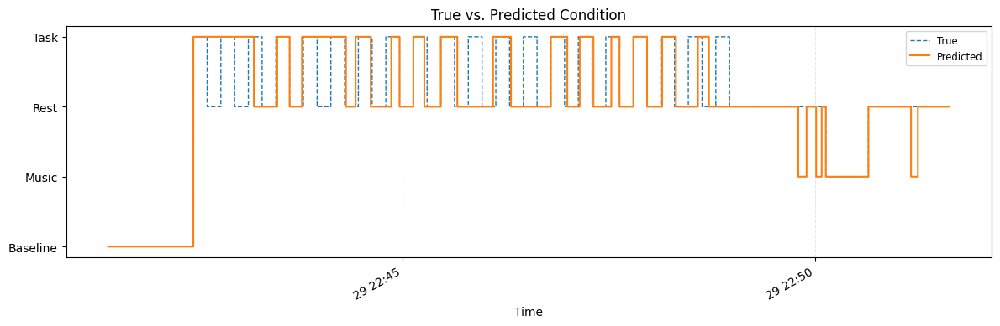

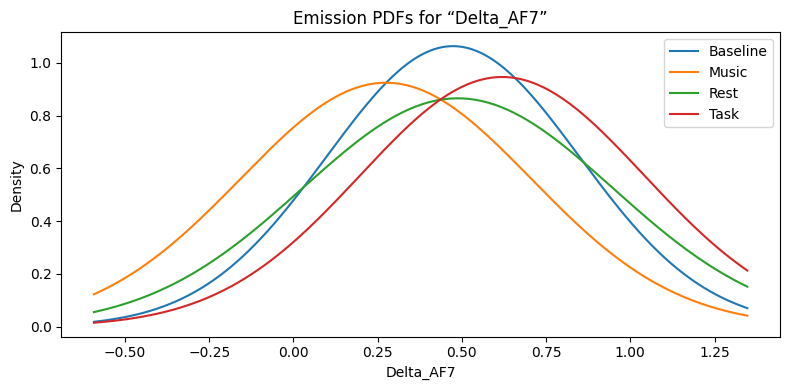

In [67]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User‐configurable file paths ===
# eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
# log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/eeg_experiment_timeline_log_10.txt"

# === User‐configurable file paths ===
# eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-9/mindMonitor_2025-04-30--13-53-32_9.csv"
# log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-9/eeg_experiment_timeline_log_9.txt"

# === User‐configurable file paths ===
eeg_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-8/mindMonitor_2025-04-29--22-41-21_8.csv"
log_file = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-8/eeg_experiment_timeline_log_8.txt"

# List the columns you want to use as your observation features.
# E.g. try ["Alpha_TP9","Alpha_TP10"] or ["Delta_TP9","Theta_TP9","Alpha_TP9"], etc.
# If this list is empty, the script will fall back to using all numeric columns.
# selected_features = [
#     "Delta_TP9", "Theta_TP9", "Alpha_TP9",
#     "Beta_TP9", "Gamma_TP9"
# ]

selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]

# === 1) Load & clean EEG data ===
df = pd.read_csv(eeg_file)

# drop any Muse “event” lines so they don't pollute features
if "Elements" in df.columns:
    df = df[df["Elements"].isna()]

# parse timestamps & index
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# === 2) Load sync log & build absolute condition intervals ===
sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
sync_df.dropna(inplace=True)

# find experiment unix start + 2h offset
exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
t0   = exp0 + 2*3600
to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

intervals = {"Baseline": [], "Task": [], "Rest": [], "Music": []}

# baseline
b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
intervals["Baseline"].append((to_ts(b0), to_ts(b1)))

# task & rest
for i,row in sync_df.iterrows():
    ev, offs = row["Event"], row["Time"]
    if "Task Start" in ev:
        intervals["Task"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))
    if "Rest Start" in ev:
        intervals["Rest"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))

# music (optional)
if "Music Start" in sync_df["Event"].values:
    m0 = sync_df.loc[sync_df["Event"]=="Music Start", "Time"].iat[0]
    m1 = sync_df.loc[sync_df["Event"]=="Music End",   "Time"].iat[0]
    intervals["Music"].append((to_ts(m0), to_ts(m1)))

# === 3) Label each sample with its condition ===
df["Condition"] = "Unlabeled"
for cond, spans in intervals.items():
    for start,end in spans:
        df.loc[(df.index>=start)&(df.index<=end), "Condition"] = cond
df = df[df["Condition"]!="Unlabeled"]  # drop any outside intervals

# === 4) Select features & build arrays ===
# determine which columns to use
if selected_features:
    missing = set(selected_features) - set(df.columns)
    if missing:
        print(f"Warning: these selected_features were not found and will be skipped: {missing}")
    feature_cols = [c for c in selected_features if c in df.columns]
else:
    # fallback: all numeric columns (drops TimeStamp / Elements / Condition automatically)
    feature_cols = df.select_dtypes(include=[np.number]).columns.tolist()

print(f"Using {len(feature_cols)} features:", feature_cols)

# build X, y_true, times
X      = df[feature_cols].T.values      # shape: (n_features, n_timesteps)
y_true = df["Condition"].values         # shape: (n_timesteps,)
times  = df.index.to_numpy()            # shape: (n_timesteps,)

# === 5) Encode states & estimate HMM params ===
states    = sorted(np.unique(y_true))
state2idx = {s:i for i,s in enumerate(states)}
idx2state = {i:s for s,i in state2idx.items()}
y_idx     = np.array([state2idx[s] for s in y_true])
n_states  = len(states)

# initial π (start in the first true label)
pi = np.zeros(n_states); pi[y_idx[0]] = 1.0

# transition counts → matrix
A_counts = np.zeros((n_states,n_states))
for a,b in zip(y_idx[:-1], y_idx[1:]):
    A_counts[a,b] += 1
A = (A_counts.T / A_counts.sum(axis=1)).T
for i in range(n_states):
    if A[i].sum()==0: A[i,i]=1.0

# per‐state Gaussian emissions
means, covars = [], []
reg = 1e-2
for i in range(n_states):
    obs = X[:, y_idx==i].T
    mu  = obs.mean(axis=0)
    C   = np.cov(obs, rowvar=False)
    C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
    means.append(mu)
    covars.append(C)
means  = np.vstack(means)
covars = np.stack(covars)

# === 6) Build HMM & Viterbi decode ===
model = hmm.GaussianHMM(n_components=n_states,
                        covariance_type="full",
                        init_params="")
model.startprob_ = pi
model.transmat_  = A
model.means_     = means
model.covars_    = covars

_, y_pred_idx = model.decode(X.T, algorithm="viterbi")
y_pred = np.array([idx2state[i] for i in y_pred_idx])

# accuracy
acc = (y_pred==y_true).mean()
print(f"Viterbi decoding accuracy: {acc*100:.2f}%")

# === 7) Plot true vs predicted states ===
state_y    = {s:i for i,s in enumerate(states)}
y_true_i   = [state_y[s] for s in y_true]
y_pred_i   = [state_y[s] for s in y_pred]

fig, ax = plt.subplots(figsize=(12,4))
ax.step(times, y_true_i, where="post", linestyle="--", label="True",   lw=1)
ax.step(times, y_pred_i, where="post", linestyle="-",  label="Predicted", lw=1.5)
ax.set_yticks(list(state_y.values())); ax.set_yticklabels(states)
ax.set_xlabel("Time"); ax.set_title("True vs. Predicted Condition")
ax.legend(loc="upper right", fontsize="small"); ax.grid(axis="x", linestyle="--", alpha=0.3)
fig.autofmt_xdate(); plt.tight_layout()

# === 8) Plot example emission PDFs for the first selected feature ===
if feature_cols:
    feat_idx  = 1
    feat_name = feature_cols[feat_idx]
    vals      = X[feat_idx, :]
    xgrid     = np.linspace(vals.min(), vals.max(), 200)

    fig2, ax2 = plt.subplots(figsize=(8,4))
    for i,state in enumerate(states):
        mu  = means[i, feat_idx]
        var = covars[i, feat_idx, feat_idx]
        pdf = 1/np.sqrt(2*np.pi*var) * np.exp(-0.5*((xgrid-mu)**2/var))
        ax2.plot(xgrid, pdf, label=state)
    ax2.set_xlabel(feat_name)
    ax2.set_ylabel("Density")
    ax2.set_title(f"Emission PDFs for “{feat_name}”")
    ax2.legend()
    plt.tight_layout()

plt.show()


sub-1: Viterbi accuracy = 60.54%
sub-10: Viterbi accuracy = 67.97%
sub-2: Viterbi accuracy = 78.74%
sub-3: Viterbi accuracy = 63.72%
sub-4: Viterbi accuracy = 82.53%
sub-5: Viterbi accuracy = 64.73%
sub-6: Viterbi accuracy = 76.14%
sub-7: Viterbi accuracy = 74.30%
sub-8: Viterbi accuracy = 80.36%
sub-9: Viterbi accuracy = 69.74%


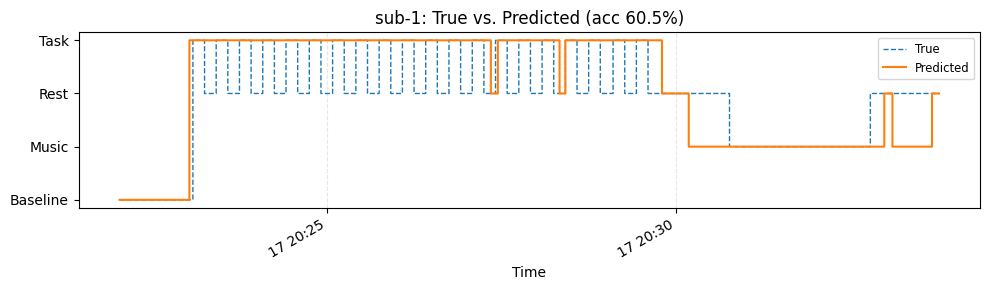

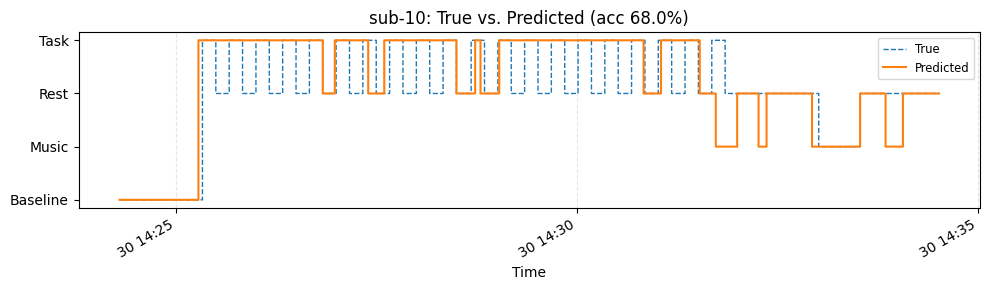

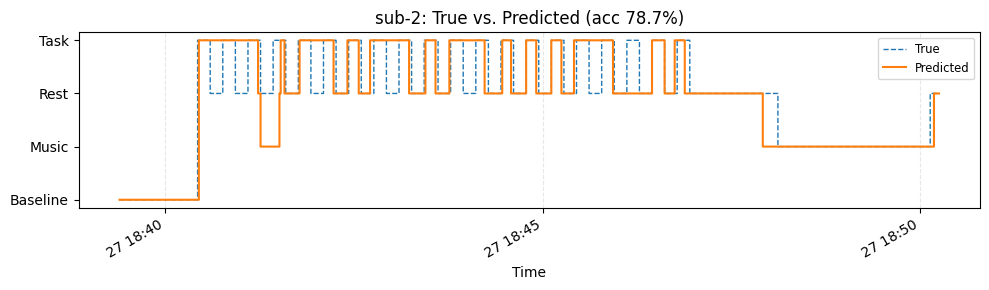

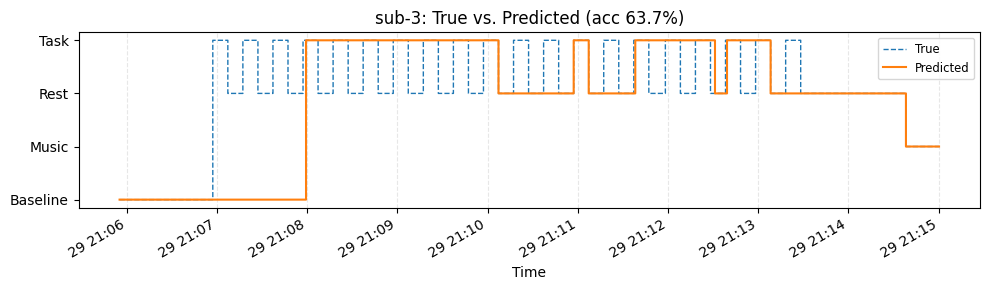

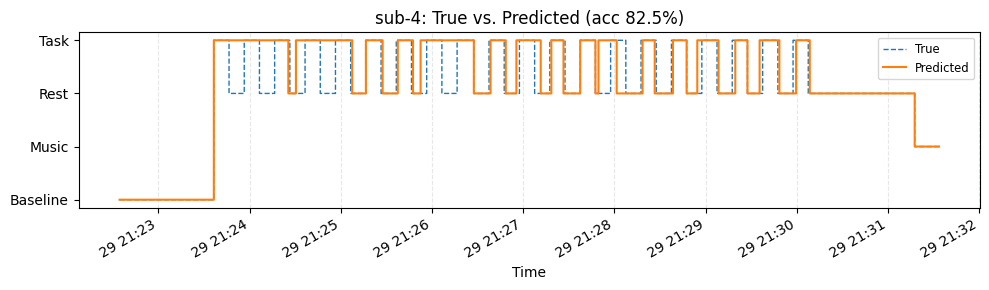

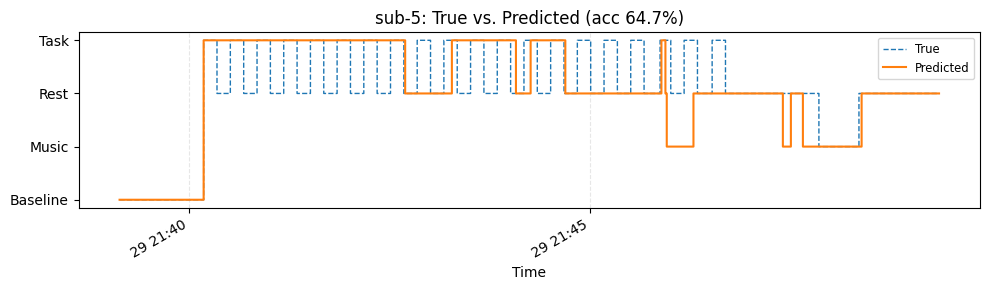

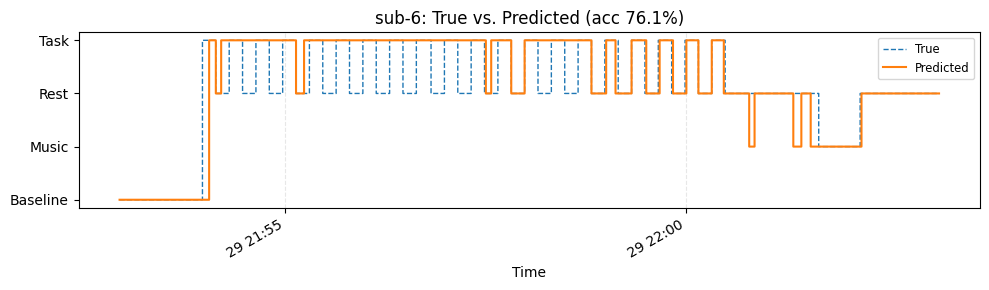

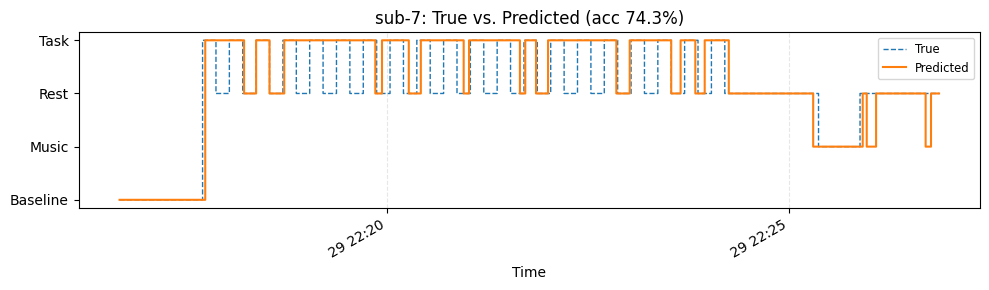

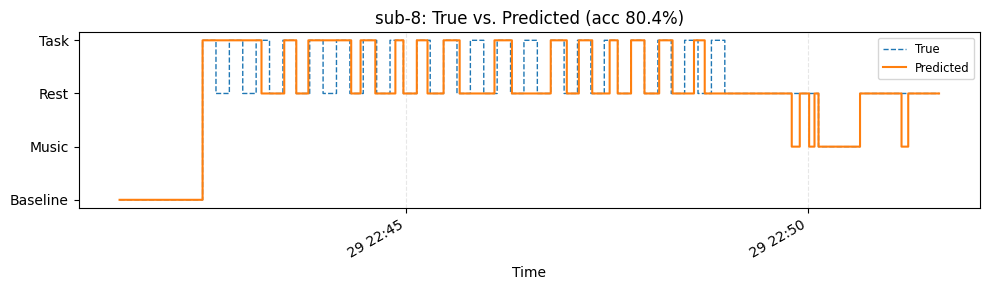

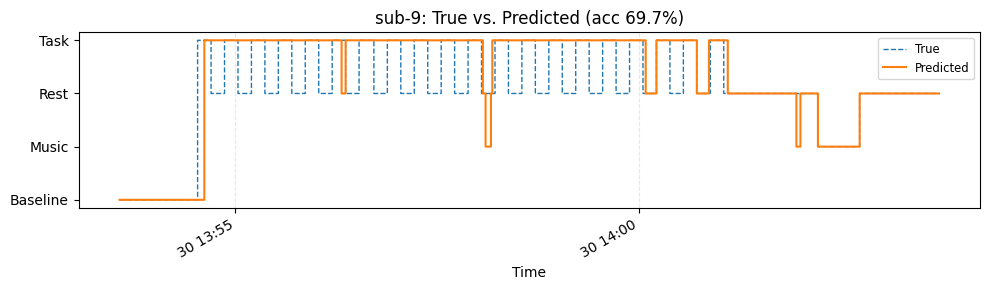

In [68]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User settings ===
root_dir = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all"  # directory containing sub-1, sub-2, etc.
# If you want to try specific features, list them here; leave empty to use all numeric columns:
selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]

# Find all subject folders sub-*
subject_dirs = sorted(glob.glob(os.path.join(root_dir, "sub-*")))

for subj_dir in subject_dirs:
    subj_id = os.path.basename(subj_dir)
    # locate the EEG CSV and log file by pattern
    eeg_files = glob.glob(os.path.join(subj_dir, "*mindMonitor*.csv"))
    log_files = glob.glob(os.path.join(subj_dir, "*eeg_experiment_timeline_log*.txt"))
    if not eeg_files or not log_files:
        print(f"{subj_id}: missing data or log file, skipping")
        continue
    eeg_file = eeg_files[0]
    log_file = log_files[0]

    # === 1) Load & clean EEG data ===
    df = pd.read_csv(eeg_file)
    if "Elements" in df.columns:
        df = df[df["Elements"].isna()]
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # === 2) Load sync log & build intervals ===
    sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
    sync_df.dropna(inplace=True)
    exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
    t0   = exp0 + 2*3600
    to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

    intervals = {"Baseline": [], "Task": [], "Rest": [], "Music": []}
    # Baseline
    b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
    b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
    intervals["Baseline"].append((to_ts(b0), to_ts(b1)))
    # Task & Rest
    for i,row in sync_df.iterrows():
        ev, offs = row["Event"], row["Time"]
        if "Task Start" in ev:
            intervals["Task"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))
        if "Rest Start" in ev:
            intervals["Rest"].append((to_ts(offs), to_ts(sync_df.at[i+1,"Time"])))
    # Music
    if "Music Start" in sync_df["Event"].values:
        m0 = sync_df.loc[sync_df["Event"]=="Music Start", "Time"].iat[0]
        m1 = sync_df.loc[sync_df["Event"]=="Music End",   "Time"].iat[0]
        intervals["Music"].append((to_ts(m0), to_ts(m1)))

    # === 3) Label each sample ===
    df["Condition"] = "Unlabeled"
    for cond, spans in intervals.items():
        for start, end in spans:
            df.loc[(df.index>=start)&(df.index<=end), "Condition"] = cond
    df = df[df["Condition"]!="Unlabeled"]

    # === 4) Select features & build arrays ===
    if selected_features:
        missing = set(selected_features) - set(df.columns)
        if missing:
            print(f"{subj_id}: warning, missing selected_features {missing}")
        feature_cols = [c for c in selected_features if c in df.columns]
    else:
        feature_cols = df.select_dtypes(include=[np.number]).columns.tolist()

    X      = df[feature_cols].T.values      # (n_features, n_timesteps)
    y_true = df["Condition"].values         # (n_timesteps,)
    times  = df.index.to_numpy()            # (n_timesteps,)

    # === 5) Encode states & estimate HMM params ===
    states    = sorted(np.unique(y_true))
    state2idx = {s:i for i,s in enumerate(states)}
    idx2state = {i:s for s,i in state2idx.items()}
    y_idx     = np.array([state2idx[s] for s in y_true])
    n_states  = len(states)

    # π
    pi = np.zeros(n_states); pi[y_idx[0]] = 1.0
    # A
    A_counts = np.zeros((n_states,n_states))
    for a,b in zip(y_idx[:-1], y_idx[1:]):
        A_counts[a,b] += 1
    A = (A_counts.T / A_counts.sum(axis=1)).T
    for i in range(n_states):
        if A[i].sum()==0: A[i,i]=1.0

    # emissions
    means, covars = [], []
    reg = 1e-2
    for i in range(n_states):
        obs = X[:, y_idx==i].T
        mu  = obs.mean(axis=0)
        C   = np.cov(obs, rowvar=False)
        C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
        means.append(mu); covars.append(C)
    means  = np.vstack(means)
    covars = np.stack(covars)

    # === 6) Build HMM & decode ===
    model = hmm.GaussianHMM(n_components=n_states,
                            covariance_type="full",
                            init_params="")
    model.startprob_ = pi
    model.transmat_  = A
    model.means_     = means
    model.covars_    = covars

    _, y_pred_idx = model.decode(X.T, algorithm="viterbi")
    y_pred = np.array([idx2state[i] for i in y_pred_idx])

    # accuracy
    acc = (y_pred == y_true).mean()
    print(f"{subj_id}: Viterbi accuracy = {acc*100:.2f}%")

    # === 7) Plot ===
    state_y  = {s:i for i,s in enumerate(states)}
    y_true_i = [state_y[s] for s in y_true]
    y_pred_i = [state_y[s] for s in y_pred]

    fig, ax = plt.subplots(figsize=(10,3))
    ax.step(times, y_true_i, where="post", linestyle="--", label="True",   lw=1)
    ax.step(times, y_pred_i, where="post", linestyle="-",  label="Predicted", lw=1.5)
    ax.set_yticks(list(state_y.values())); ax.set_yticklabels(states)
    ax.set_title(f"{subj_id}: True vs. Predicted (acc {acc*100:.1f}%)")
    ax.set_xlabel("Time"); ax.grid(axis="x", linestyle="--", alpha=0.3)
    ax.legend(loc="upper right", fontsize="small")
    fig.autofmt_xdate()
    plt.tight_layout()

plt.show()


sub-1: Viterbi accuracy = 84.44%
sub-10: Viterbi accuracy = 78.38%
sub-11: Viterbi accuracy = 63.78%
sub-12: Viterbi accuracy = 85.95%
sub-14: Viterbi accuracy = 80.56%
sub-16: Viterbi accuracy = 64.32%
sub-17: Viterbi accuracy = 79.73%
sub-18: Viterbi accuracy = 61.22%
sub-19: Viterbi accuracy = 87.57%
sub-2: Viterbi accuracy = 96.39%
sub-3: Viterbi accuracy = 73.78%


/var/folders/5z/ymdd9pk1129ck37ykh2hxqhh0000gn/T/ipykernel_92039/1392130046.py:157: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,3))


sub-4: Viterbi accuracy = 90.91%
sub-5: Viterbi accuracy = 81.62%
sub-6: Viterbi accuracy = 82.97%
sub-7: Viterbi accuracy = 91.35%
sub-8: Viterbi accuracy = 82.83%
sub-9: Viterbi accuracy = 87.22%


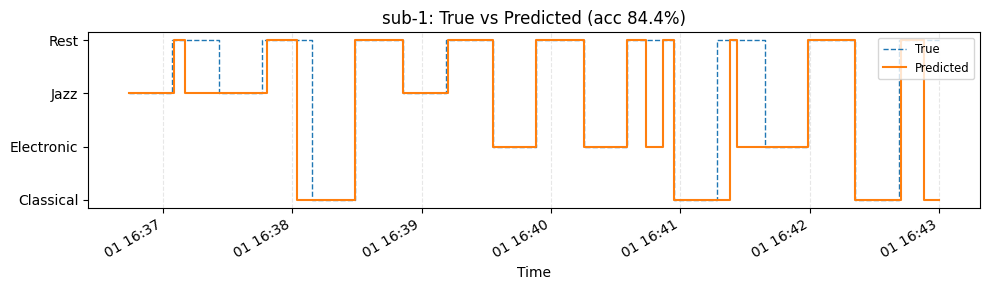

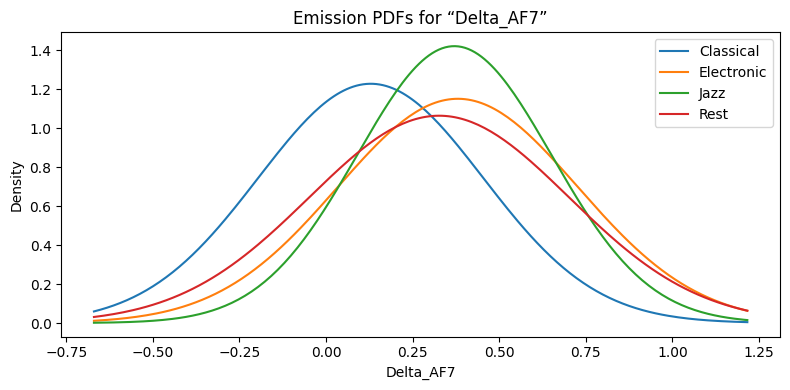

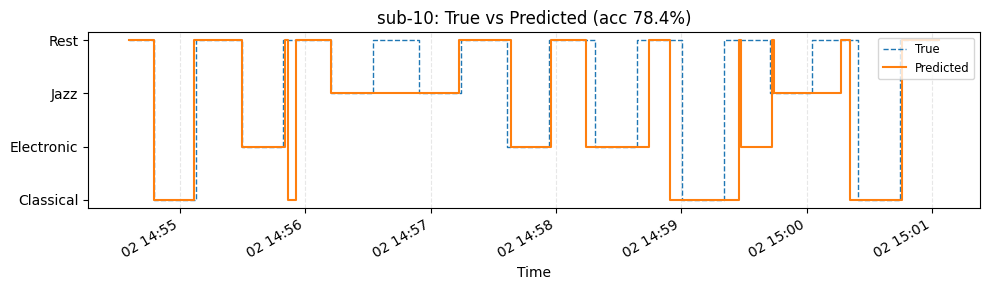

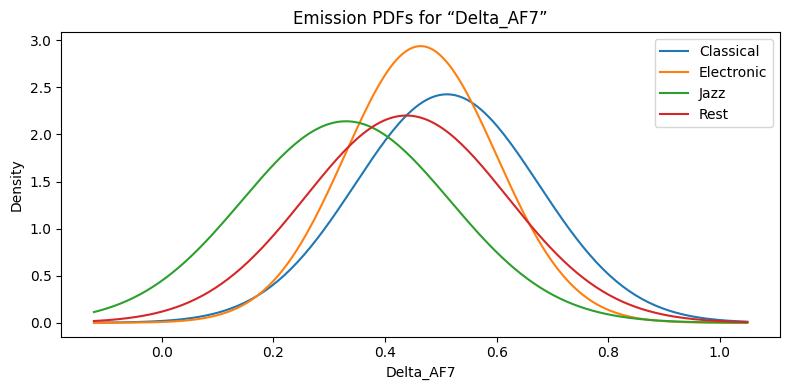

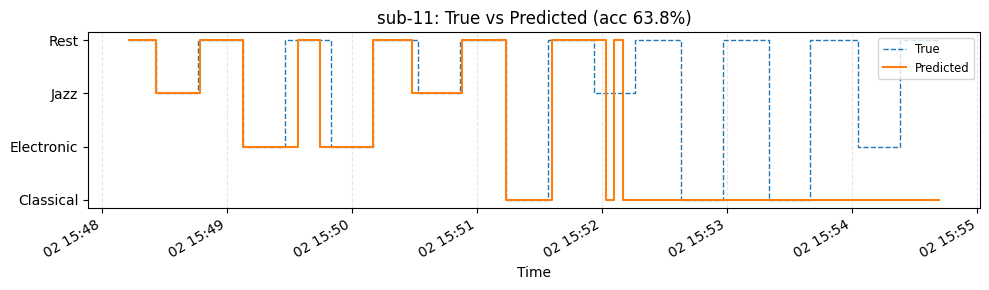

...

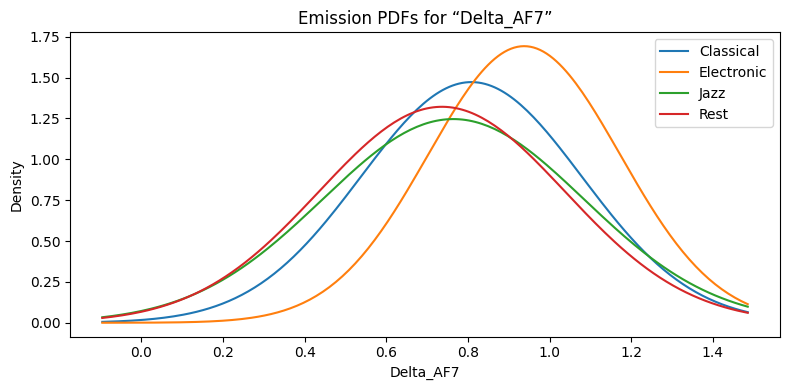

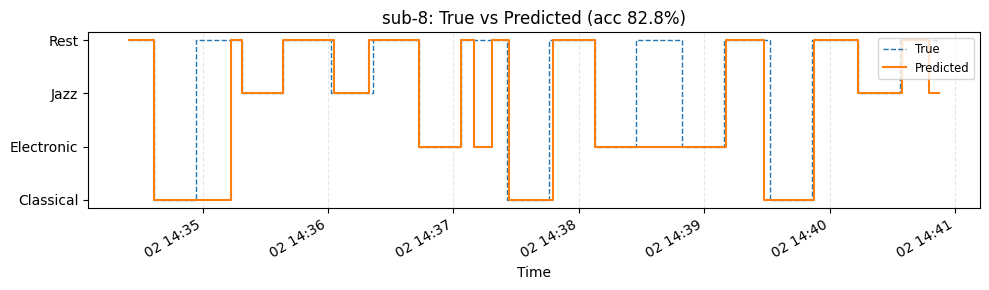

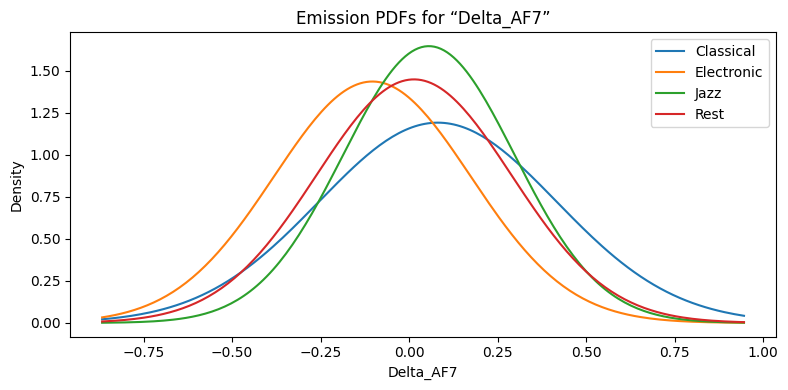

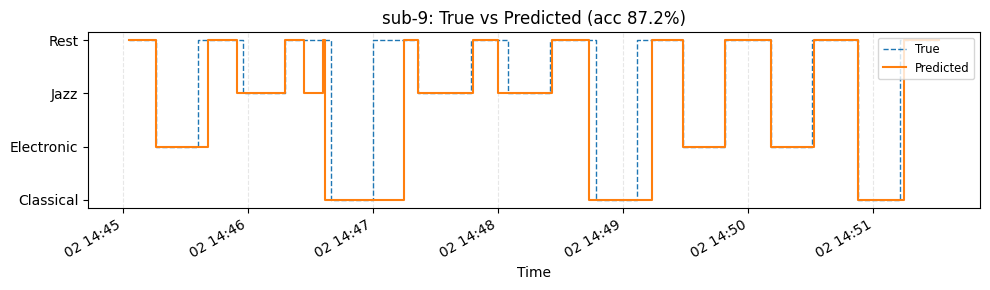

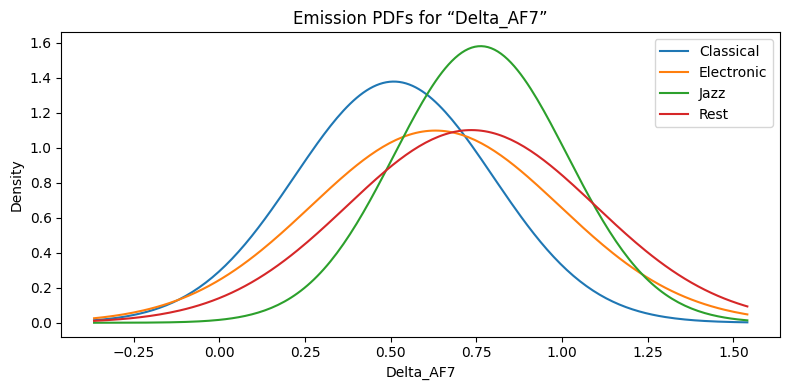

In [ ]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User settings ===
root_dir = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_MGR"  # contains sub-1, sub-2, etc.
# List specific EEG feature columns to use, or leave empty to use all numeric columns:
selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]


# find all subject folders
subject_dirs = sorted(glob.glob(os.path.join(root_dir, "sub-*")))

for subj_dir in subject_dirs:
    subj_id = os.path.basename(subj_dir)
    # locate mindMonitor CSV and log txt
    eeg_files = glob.glob(os.path.join(subj_dir, "*mindMonitor*.csv"))
    log_files = glob.glob(os.path.join(subj_dir, "*music_genre_experiment_log*.txt"))
    if not eeg_files or not log_files:
        print(f"{subj_id}: missing data or log → skipping")
        continue
    eeg_file = eeg_files[0]
    log_file = log_files[0]

    # --- 1) Load & clean EEG data ---
    df = pd.read_csv(eeg_file)
    # drop blink/jaw events
    if "Elements" in df.columns:
        df = df[df["Elements"].isna()]
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # --- 2) Load sync log & build intervals ---
    sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
    sync_df.dropna(inplace=True)
    # experiment unix start + 2h offset
    exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
    t0   = exp0 + 2*3600
    to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

    # intervals for each state
    intervals = {
        "Rest": [],     # includes baseline + post‐rest
        "Jazz": [], 
        "Classical": [], 
        "Electronic": []
    }

    # baseline → Rest
    b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
    b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
    intervals["Rest"].append((to_ts(b0), to_ts(b1)))

    # music trials and post‐rest
    for i, row in sync_df.iterrows():
        ev, offs = row["Event"], row["Time"]
        if ev.startswith("Music Start"):
            # format: "Music Start - Trial X - Genre - Duration ..."
            parts = ev.split(" - ")
            genre = parts[2]
            start = to_ts(offs)
            # next row is Music End
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals[genre].append((start, end))
        elif ev.startswith("Post Rest Start"):
            start = to_ts(offs)
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals["Rest"].append((start, end))

    # --- 3) Label each EEG sample ---
    df["Condition"] = "Unlabeled"
    for cond, spans in intervals.items():
        for start, end in spans:
            mask = (df.index >= start) & (df.index <= end)
            df.loc[mask, "Condition"] = cond
    df = df[df["Condition"] != "Unlabeled"]

    # --- 4) Select features & build arrays ---
    if selected_features:
        missing = set(selected_features) - set(df.columns)
        if missing:
            print(f"{subj_id}: warning, missing selected_features {missing}")
        feature_cols = [c for c in selected_features if c in df.columns]
    else:
        feature_cols = df.select_dtypes(include=[np.number]).columns.tolist()

    X      = df[feature_cols].T.values      # (n_features, n_timesteps)
    y_true = df["Condition"].values         # (n_timesteps,)
    times  = df.index.to_numpy()            # (n_timesteps,)

    # --- 5) Encode states & estimate HMM params ---
    states    = sorted(np.unique(y_true))
    state2idx = {s:i for i,s in enumerate(states)}
    idx2state = {i:s for s,i in state2idx.items()}
    # print(state2idx)
    # print(y_true)
    y_idx     = np.array([state2idx[s] for s in y_true])
    # print(y_idx)

    n_states  = len(states)

    # initial π
    pi = np.zeros(n_states); pi[y_idx[0]] = 1.0

    # transition matrix A
    A_counts = np.zeros((n_states, n_states))
    for a,b in zip(y_idx[:-1], y_idx[1:]):
        A_counts[a,b] += 1
    A = (A_counts.T / A_counts.sum(axis=1)).T
    for i in range(n_states):
        if A[i].sum() == 0:
            A[i,i] = 1.0

    # emission Gaussians
    means, covars = [], []
    reg = 1e-2
    for i in range(n_states):
        obs = X[:, y_idx==i].T
        mu  = obs.mean(axis=0)
        C   = np.cov(obs, rowvar=False)
        C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
        means.append(mu)
        covars.append(C)
    means  = np.vstack(means)
    covars = np.stack(covars)

    # --- 6) Build HMM & decode via Viterbi ---
    model = hmm.GaussianHMM(n_components=n_states,
                            covariance_type="full",
                            init_params="")
    model.startprob_ = pi
    model.transmat_  = A
    model.means_     = means
    model.covars_    = covars

    _, y_pred_idx = model.decode(X.T, algorithm="viterbi")
    y_pred = np.array([idx2state[i] for i in y_pred_idx])

    # accuracy
    acc = (y_pred == y_true).mean()
    print(f"{subj_id}: Viterbi accuracy = {acc*100:.2f}%")

    # --- 7) Plot true vs predicted states ---
    state_y    = {s:i for i,s in enumerate(states)}
    y_true_i   = [state_y[s] for s in y_true]
    y_pred_i   = [state_y[s] for s in y_pred]

    fig, ax = plt.subplots(figsize=(10,3))
    ax.step(times, y_true_i, where="post", linestyle="--", label="True",   lw=1)
    ax.step(times, y_pred_i, where="post", linestyle="-",  label="Predicted", lw=1.5)
    ax.set_yticks(list(state_y.values())); ax.set_yticklabels(states)
    ax.set_title(f"{subj_id}: True vs Predicted (acc {acc*100:.1f}%)")
    ax.set_xlabel("Time"); ax.grid(axis="x", linestyle="--", alpha=0.3)
    ax.legend(loc="upper right", fontsize="small")
    fig.autofmt_xdate()
    plt.tight_layout()

    # === 8) Plot example emission PDFs for the first selected feature ===
    if feature_cols:
        feat_idx  = 1
        feat_name = feature_cols[feat_idx]
        vals      = X[feat_idx, :]
        xgrid     = np.linspace(vals.min(), vals.max(), 200)

        fig2, ax2 = plt.subplots(figsize=(8,4))
        for i,state in enumerate(states):
            mu  = means[i, feat_idx]
            var = covars[i, feat_idx, feat_idx]
            pdf = 1/np.sqrt(2*np.pi*var) * np.exp(-0.5*((xgrid-mu)**2/var))
            ax2.plot(xgrid, pdf, label=state)
        ax2.set_xlabel(feat_name)
        ax2.set_ylabel("Density")
        ax2.set_title(f"Emission PDFs for “{feat_name}”")
        ax2.legend()
        plt.tight_layout()


plt.show()


sub-1: most discriminative feature → Gamma_TP9
  Viterbi accuracy = 84.44%
sub-10: most discriminative feature → Delta_TP9
  Viterbi accuracy = 78.38%
sub-11: most discriminative feature → Theta_TP10
  Viterbi accuracy = 63.78%
sub-12: most discriminative feature → Gamma_AF8
  Viterbi accuracy = 85.95%
sub-14: most discriminative feature → Alpha_TP9
  Viterbi accuracy = 80.56%
sub-16: most discriminative feature → Gamma_AF7
  Viterbi accuracy = 64.32%
sub-17: most discriminative feature → Beta_AF8
  Viterbi accuracy = 79.73%
sub-18: most discriminative feature → Beta_AF7
  Viterbi accuracy = 61.22%
sub-19: most discriminative feature → Delta_AF7
  Viterbi accuracy = 87.57%
sub-2: most discriminative feature → Alpha_AF8
  Viterbi accuracy = 96.39%
sub-3: most discriminative feature → Theta_TP9
  Viterbi accuracy = 73.78%
sub-4: most discriminative feature → Theta_AF7


/var/folders/5z/ymdd9pk1129ck37ykh2hxqhh0000gn/T/ipykernel_92039/4044265960.py:123: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8,4))


  Viterbi accuracy = 90.91%
sub-5: most discriminative feature → Theta_AF8
  Viterbi accuracy = 81.62%
sub-6: most discriminative feature → Gamma_TP10
  Viterbi accuracy = 82.97%
sub-7: most discriminative feature → Theta_TP10
  Viterbi accuracy = 91.35%
sub-8: most discriminative feature → Alpha_TP9
  Viterbi accuracy = 82.83%
sub-9: most discriminative feature → Gamma_AF7
  Viterbi accuracy = 87.22%


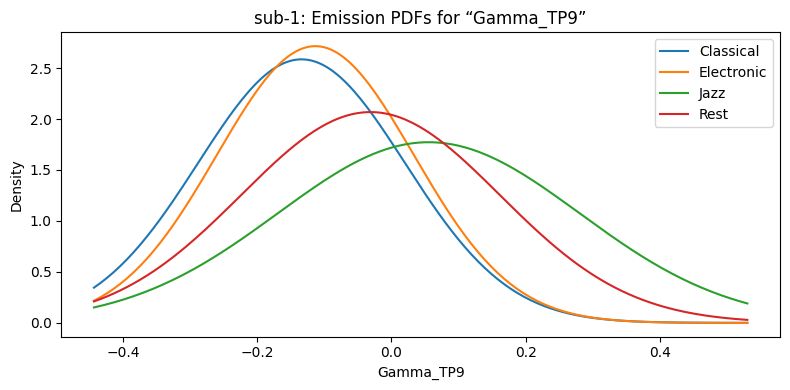

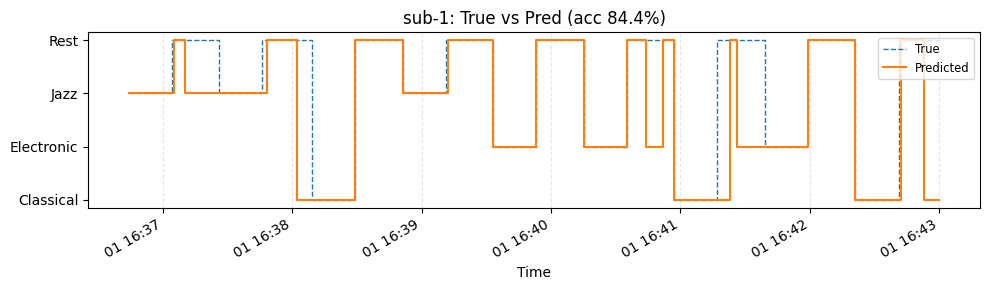

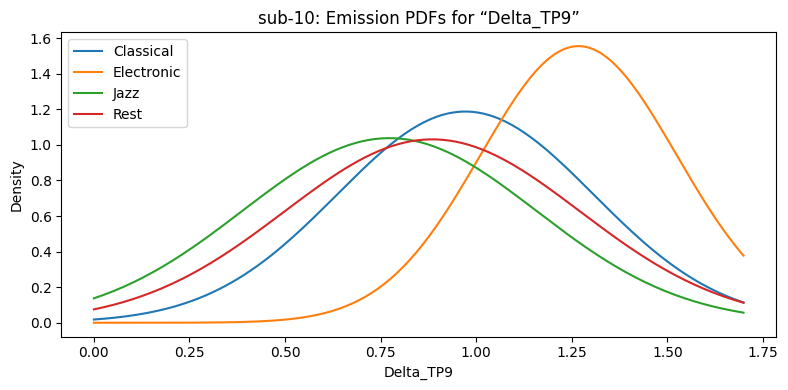

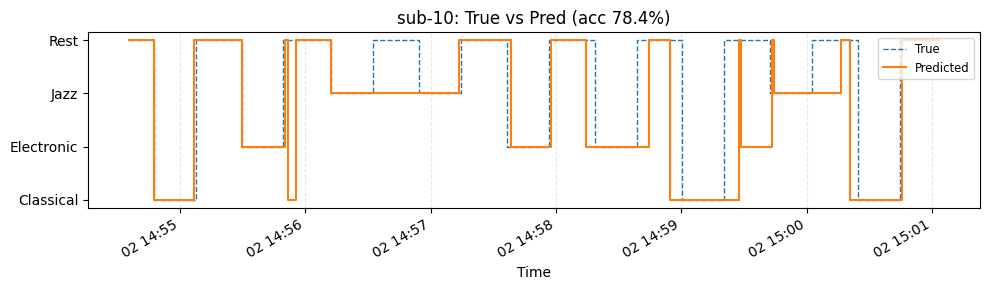

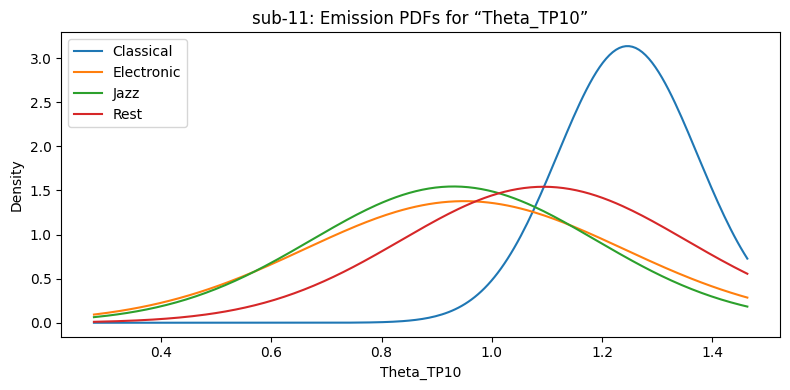

...

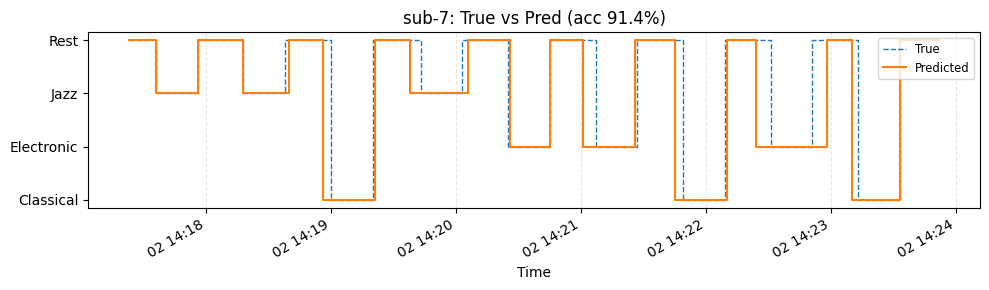

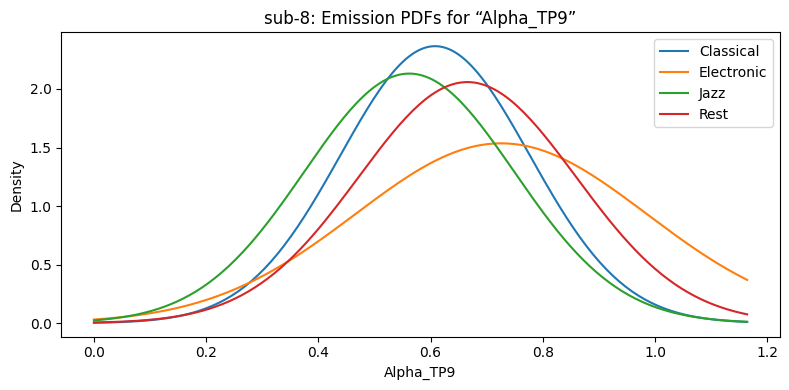

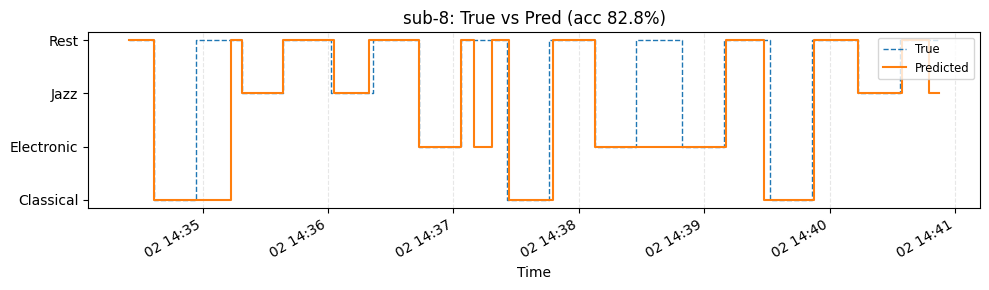

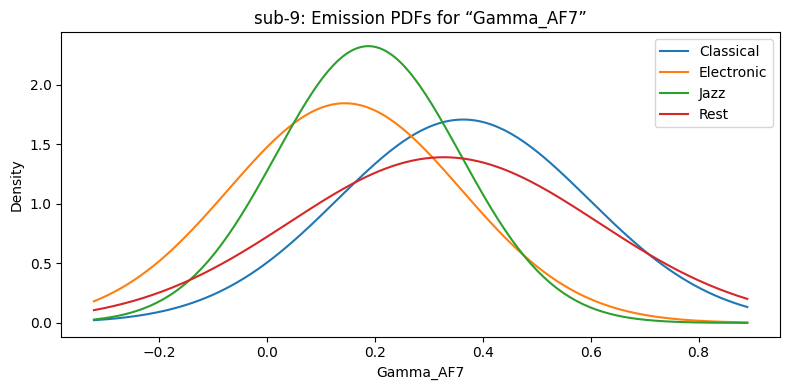

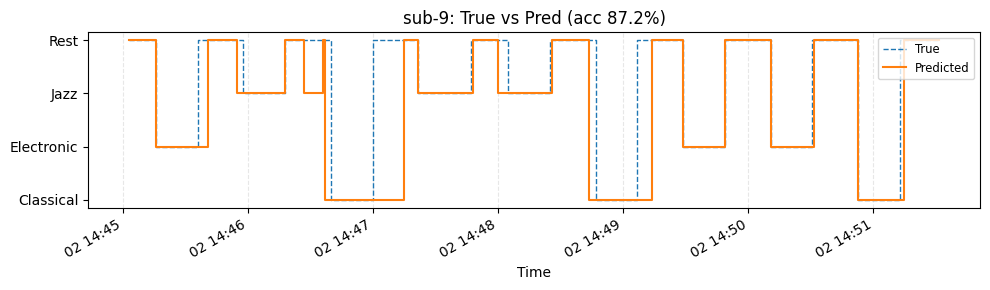

In [14]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User settings ===
root_dir = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_MGR"
selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]

subject_dirs = sorted(glob.glob(os.path.join(root_dir, "sub-*")))

for subj_dir in subject_dirs:
    subj_id = os.path.basename(subj_dir)
    # find files
    eeg_files = glob.glob(os.path.join(subj_dir, "*mindMonitor*.csv"))
    log_files = glob.glob(os.path.join(subj_dir, "*music_genre_experiment_log*.txt"))
    if not eeg_files or not log_files:
        print(f"{subj_id}: missing data/log → skipping")
        continue
    eeg_file, log_file = eeg_files[0], log_files[0]

    # --- 1) Load & clean EEG ---
    df = pd.read_csv(eeg_file)
    if "Elements" in df.columns:
        df = df[df["Elements"].isna()]
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # --- 2) Parse log & build intervals ---
    sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
    sync_df.dropna(inplace=True)
    exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
    t0   = exp0 + 2*3600
    to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

    intervals = {"Rest": [], "Jazz": [], "Classical": [], "Electronic": []}
    # Baseline → Rest
    b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
    b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
    intervals["Rest"].append((to_ts(b0), to_ts(b1)))

    # Music & Post‐Rest
    for i,row in sync_df.iterrows():
        ev, offs = row["Event"], row["Time"]
        if ev.startswith("Music Start"):
            genre = ev.split(" - ")[2]
            start, end = to_ts(offs), to_ts(sync_df.at[i+1,"Time"])
            intervals[genre].append((start,end))
        elif ev.startswith("Post Rest Start"):
            start, end = to_ts(offs), to_ts(sync_df.at[i+1,"Time"])
            intervals["Rest"].append((start,end))

    # --- 3) Label each sample ---
    df["Condition"] = "Unlabeled"
    for cond, spans in intervals.items():
        for start,end in spans:
            df.loc[(df.index>=start)&(df.index<=end),"Condition"] = cond
    df = df[df["Condition"]!="Unlabeled"]

    # --- 4) Select features & build arrays ---
    feature_cols = [c for c in selected_features if c in df.columns]
    X      = df[feature_cols].T.values      # (n_features, n_timesteps)
    y_true = df["Condition"].values         # (n_timesteps,)
    times  = df.index.to_numpy()            # (n_timesteps,)

    # --- 5) Encode states & estimate HMM params ---
    states    = sorted(np.unique(y_true))
    state2idx = {s:i for i,s in enumerate(states)}
    idx2state = {i:s for s,i in state2idx.items()}
    y_idx     = np.array([state2idx[s] for s in y_true])
    n_states  = len(states)

    # π
    pi = np.zeros(n_states); pi[y_idx[0]] = 1.0
    # A
    A_counts = np.zeros((n_states,n_states))
    for a,b in zip(y_idx[:-1], y_idx[1:]):
        A_counts[a,b] += 1
    A = (A_counts.T / A_counts.sum(axis=1)).T
    for i in range(n_states):
        if A[i].sum()==0: A[i,i]=1.0

    # Emission Gaussians
    means, covars = [], []
    reg = 1e-2
    for i in range(n_states):
        obs = X[:, y_idx==i].T
        mu  = obs.mean(axis=0)
        C   = np.cov(obs, rowvar=False)
        C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
        means.append(mu)
        covars.append(C)
    means  = np.vstack(means)              # (n_states, n_feats)
    covars = np.stack(covars)              # (n_states, n_feats, n_feats)

    # --- 5a) Compute Fisher‐ratio per feature ---
    counts = np.array([np.sum(y_idx==i) for i in range(n_states)])
    fisher_scores = []
    for j in range(len(feature_cols)):
        # global mean of feature j
        global_mean = np.dot(counts, means[:,j]) / counts.sum()
        between = np.sum(counts * (means[:,j] - global_mean)**2)
        within  = np.sum(counts * covars[:,j,j])
        score   = between/within if within>0 else 0
        fisher_scores.append(score)

    best_j      = int(np.argmax(fisher_scores))
    best_feat   = feature_cols[best_j]
    print(f"{subj_id}: most discriminative feature → {best_feat}")

    # --- 6) Plot its emission PDFs ---
    xvals = X[best_j,:]
    grid  = np.linspace(xvals.min(), xvals.max(), 200)

    fig, ax = plt.subplots(figsize=(8,4))
    for i, st in enumerate(states):
        mu  = means[i, best_j]
        var = covars[i, best_j, best_j]
        pdf = 1/np.sqrt(2*np.pi*var) * np.exp(-0.5*(grid-mu)**2/var)
        ax.plot(grid, pdf, label=st)
    ax.set_xlabel(best_feat)
    ax.set_ylabel("Density")
    ax.set_title(f"{subj_id}: Emission PDFs for “{best_feat}”")
    ax.legend()
    plt.tight_layout()

    # --- 7) (Optional) run & plot Viterbi as before ---
    model = hmm.GaussianHMM(n_components=n_states, covariance_type="full", init_params="")
    model.startprob_, model.transmat_, model.means_, model.covars_ = pi, A, means, covars
    _, y_pred_idx = model.decode(X.T, algorithm="viterbi")
    acc = (y_pred_idx == y_idx).mean()
    print(f"  Viterbi accuracy = {acc*100:.2f}%")

    fig2, ax2 = plt.subplots(figsize=(10,3))
    yt = [state2idx[s] for s in y_true]
    yp = y_pred_idx
    ax2.step(times, yt, where="post", linestyle="--", label="True",   lw=1)
    ax2.step(times, yp, where="post", linestyle="-",  label="Predicted", lw=1.5)
    ax2.set_yticks(range(n_states)); ax2.set_yticklabels(states)
    ax2.set_title(f"{subj_id}: True vs Pred (acc {acc*100:.1f}%)")
    ax2.set_xlabel("Time"); ax2.grid(axis="x", linestyle="--", alpha=0.3)
    ax2.legend(loc="upper right", fontsize="small")
    fig2.autofmt_xdate()
    plt.tight_layout()

plt.show()


sub-1: Viterbi accuracy = 84.44%
sub-10: Viterbi accuracy = 78.38%
sub-11: Viterbi accuracy = 63.78%
sub-12: Viterbi accuracy = 85.95%
sub-14: Viterbi accuracy = 80.56%
sub-16: Viterbi accuracy = 64.32%
sub-17: Viterbi accuracy = 79.73%
sub-18: Viterbi accuracy = 61.22%
sub-19: Viterbi accuracy = 87.57%
sub-2: Viterbi accuracy = 96.39%


/var/folders/5z/ymdd9pk1129ck37ykh2hxqhh0000gn/T/ipykernel_92039/1719938025.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(len(bands), 1,


sub-3: Viterbi accuracy = 73.78%
sub-4: Viterbi accuracy = 90.91%
sub-5: Viterbi accuracy = 81.62%
sub-6: Viterbi accuracy = 82.97%
sub-7: Viterbi accuracy = 91.35%
sub-8: Viterbi accuracy = 82.83%
sub-9: Viterbi accuracy = 87.22%


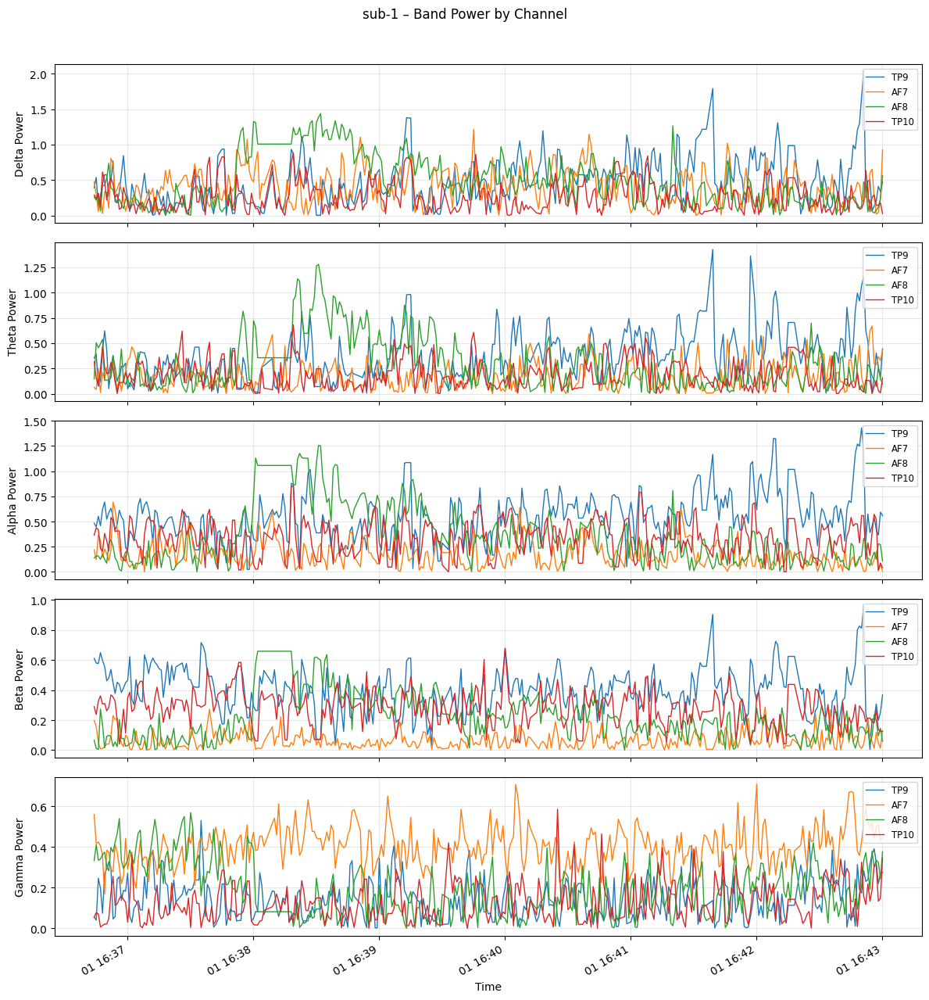

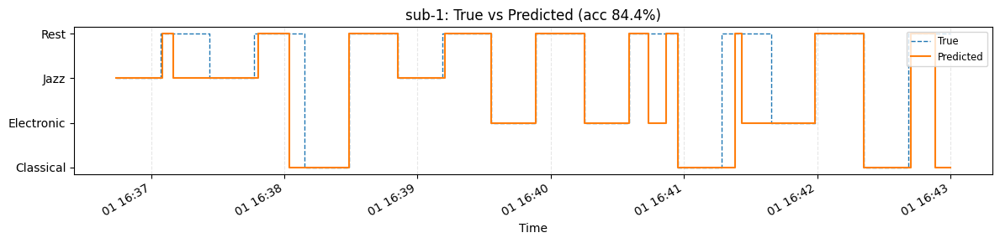

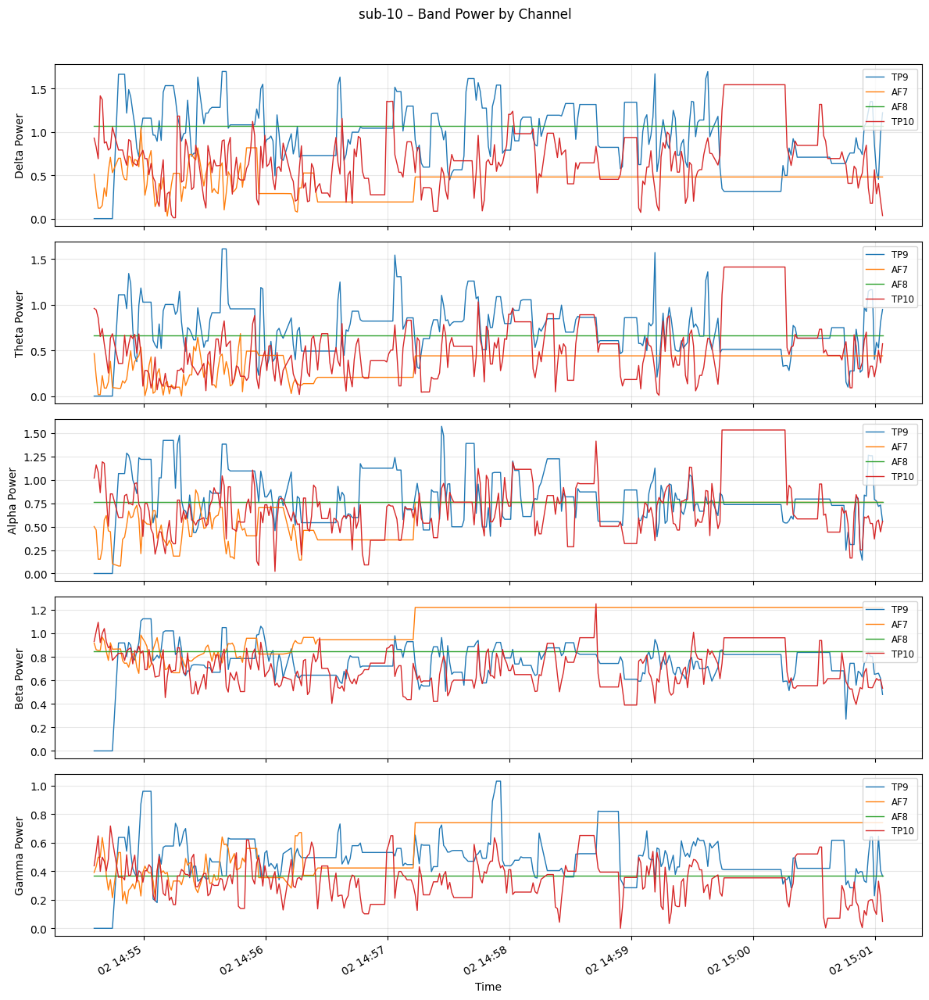

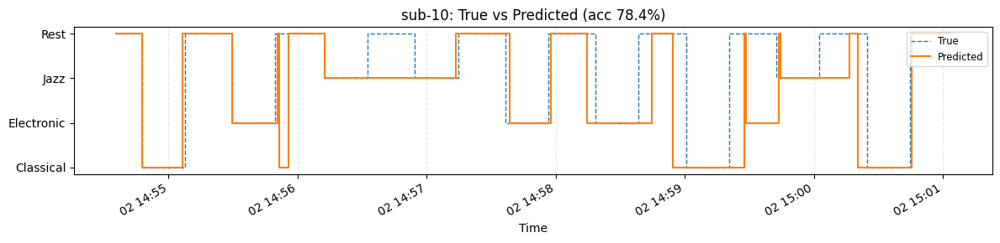

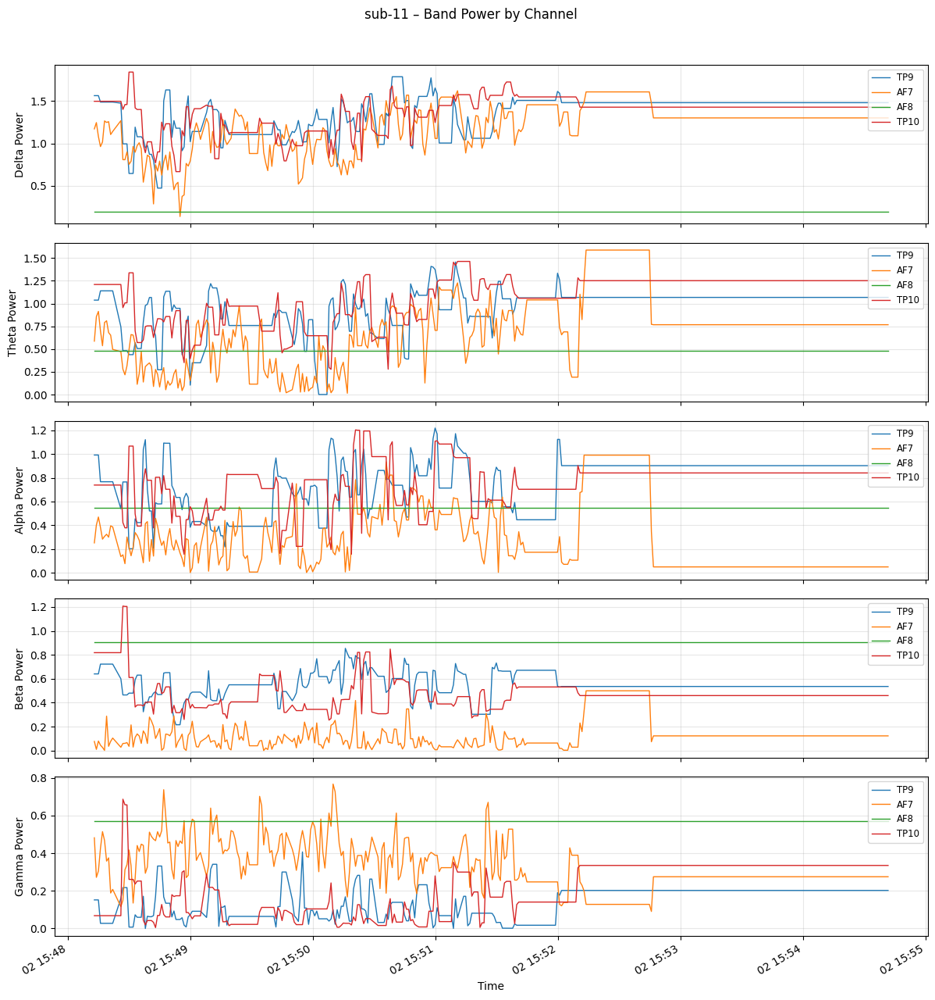

...

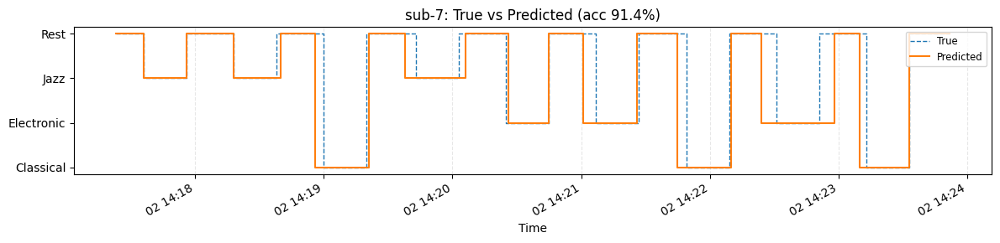

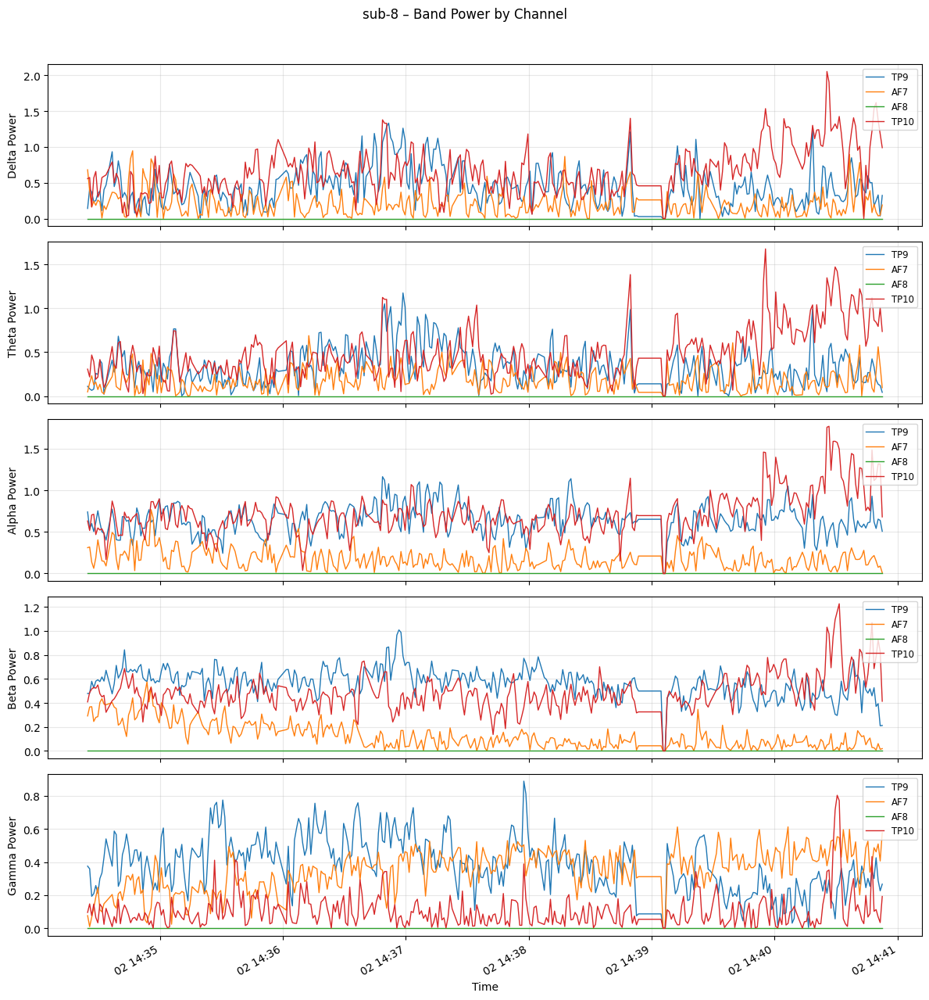

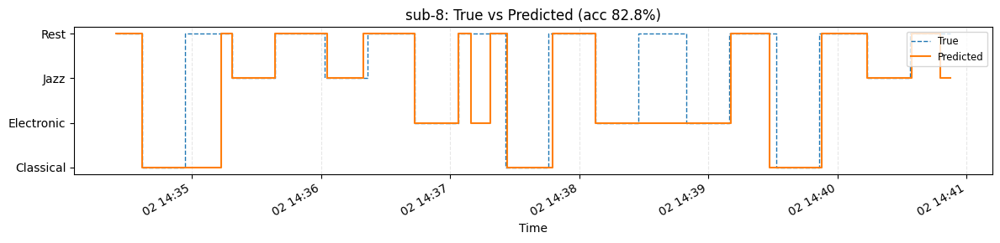

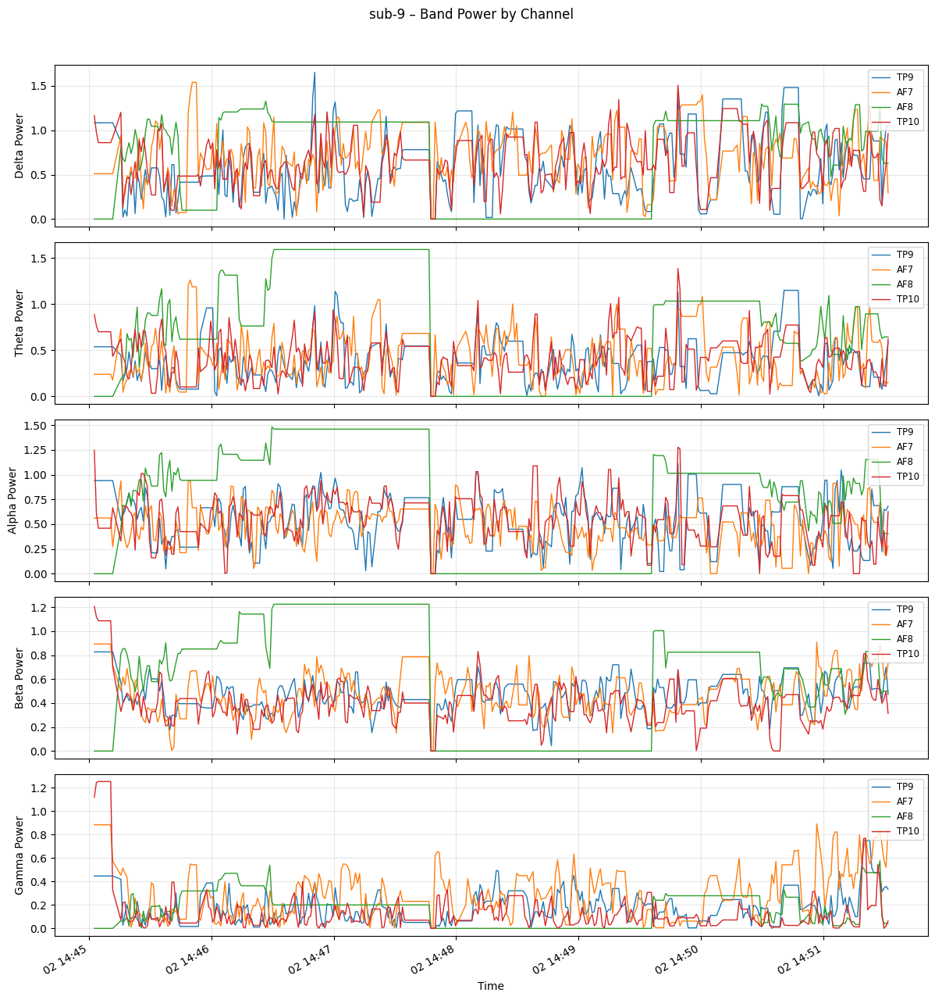

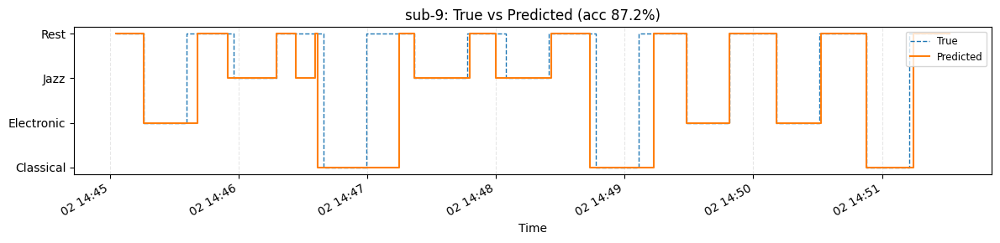

In [11]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User settings ===
root_dir = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_MGR"  # contains sub-1, sub-2, etc.
# List specific EEG feature columns to use, or leave empty to use all numeric columns:
selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]

# find all subject folders
subject_dirs = sorted(glob.glob(os.path.join(root_dir, "sub-*")))

for subj_dir in subject_dirs:
    subj_id = os.path.basename(subj_dir)
    # locate mindMonitor CSV and log txt
    eeg_files = glob.glob(os.path.join(subj_dir, "*mindMonitor*.csv"))
    log_files = glob.glob(os.path.join(subj_dir, "*music_genre_experiment_log*.txt"))
    if not eeg_files or not log_files:
        print(f"{subj_id}: missing data or log → skipping")
        continue
    eeg_file = eeg_files[0]
    log_file = log_files[0]

    # --- 1) Load & clean EEG data ---
    df = pd.read_csv(eeg_file)
    # drop blink/jaw events
    if "Elements" in df.columns:
        df = df[df["Elements"].isna()]
    # parse timestamps & index
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # --- 2) Load sync log & build intervals ---
    sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
    sync_df.dropna(inplace=True)
    # experiment unix start + 2h offset
    exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
    t0   = exp0 + 2*3600
    to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

    intervals = {
        "Rest": [],       # baseline + post-rest
        "Jazz": [],
        "Classical": [],
        "Electronic": []
    }
    # baseline → Rest
    b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
    b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
    intervals["Rest"].append((to_ts(b0), to_ts(b1)))
    # music & post-rest
    for i, row in sync_df.iterrows():
        ev, offs = row["Event"], row["Time"]
        if ev.startswith("Music Start"):
            genre = ev.split(" - ")[2]
            start = to_ts(offs)
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals[genre].append((start, end))
        elif ev.startswith("Post Rest Start"):
            start = to_ts(offs)
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals["Rest"].append((start, end))

    # --- 3) Label each EEG sample ---
    df["Condition"] = "Unlabeled"
    for cond, spans in intervals.items():
        for start, end in spans:
            df.loc[(df.index>=start)&(df.index<=end), "Condition"] = cond
    df = df[df["Condition"] != "Unlabeled"]

    # --- 4) Select features & build arrays ---
    if selected_features:
        missing = set(selected_features) - set(df.columns)
        if missing:
            print(f"{subj_id}: warning, missing selected_features {missing}")
        feature_cols = [c for c in selected_features if c in df.columns]
    else:
        feature_cols = df.select_dtypes(include=[np.number]).columns.tolist()

    X      = df[feature_cols].T.values      # (n_features, n_timesteps)
    y_true = df["Condition"].values         # (n_timesteps,)
    times  = df.index.to_numpy()            # (n_timesteps,)

    # --- 4b) Plot band-power channels for each band ---
    bands    = ["Delta", "Theta", "Alpha", "Beta", "Gamma"]
    channels = ["TP9", "AF7", "AF8", "TP10"]

    fig, axs = plt.subplots(len(bands), 1,
                            figsize=(12, 2.5*len(bands)),
                            sharex=True)
    if len(bands) == 1:
        axs = [axs]

    for ax, band in zip(axs, bands):
        for ch in channels:
            col = f"{band}_{ch}"
            if col in df.columns:
                ax.plot(times,
                        df[col].abs(),
                        label=ch,
                        linewidth=1)
        ax.set_ylabel(f"{band} Power")
        ax.legend(loc="upper right", fontsize="small")
        ax.grid(alpha=0.3)

    axs[-1].set_xlabel("Time")
    fig.suptitle(f"{subj_id} – Band Power by Channel", y=1.02)
    fig.autofmt_xdate()
    plt.tight_layout()


    # --- 5) Encode states & estimate HMM params ---
    states    = sorted(np.unique(y_true))
    state2idx = {s:i for i,s in enumerate(states)}
    idx2state = {i:s for s,i in state2idx.items()}
    y_idx     = np.array([state2idx[s] for s in y_true])
    n_states  = len(states)

    # initial π
    pi = np.zeros(n_states); pi[y_idx[0]] = 1.0
    # transition matrix A
    A_counts = np.zeros((n_states, n_states))
    for a,b in zip(y_idx[:-1], y_idx[1:]):
        A_counts[a,b] += 1
    A = (A_counts.T / A_counts.sum(axis=1)).T
    for i in range(n_states):
        if A[i].sum() == 0:
            A[i,i] = 1.0

    # emission Gaussians
    means, covars = [], []
    reg = 1e-2
    for i in range(n_states):
        obs = X[:, y_idx==i].T
        mu  = obs.mean(axis=0)
        C   = np.cov(obs, rowvar=False)
        C   = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
        means.append(mu); covars.append(C)
    means  = np.vstack(means)
    covars = np.stack(covars)

    # --- 6) Build HMM & decode via Viterbi ---
    model = hmm.GaussianHMM(n_components=n_states,
                            covariance_type="full",
                            init_params="")
    model.startprob_ = pi
    model.transmat_  = A
    model.means_     = means
    model.covars_    = covars

    _, y_pred_idx = model.decode(X.T, algorithm="viterbi")
    y_pred = np.array([idx2state[i] for i in y_pred_idx])

    # accuracy
    acc = (y_pred == y_true).mean()
    print(f"{subj_id}: Viterbi accuracy = {acc*100:.2f}%")

    # --- 7) Plot true vs predicted states ---
    state_y  = {s:i for i,s in enumerate(states)}
    y_true_i = [state_y[s] for s in y_true]
    y_pred_i = [state_y[s] for s in y_pred]

    fig2, ax2 = plt.subplots(figsize=(12,3))
    ax2.step(times, y_true_i, where="post", linestyle="--", label="True",   lw=1)
    ax2.step(times, y_pred_i, where="post", linestyle="-",  label="Predicted", lw=1.5)
    ax2.set_yticks(list(state_y.values())); ax2.set_yticklabels(states)
    ax2.set_title(f"{subj_id}: True vs Predicted (acc {acc*100:.1f}%)")
    ax2.set_xlabel("Time"); ax2.grid(axis="x", linestyle="--", alpha=0.3)
    ax2.legend(loc="upper right", fontsize="small")
    fig2.autofmt_xdate()
    plt.tight_layout()

plt.show()


sub-1: global‐model accuracy = 60.00%
sub-10: global‐model accuracy = 24.05%
sub-11: global‐model accuracy = 46.22%
sub-12: global‐model accuracy = 38.65%
sub-14: global‐model accuracy = 48.89%
sub-16: global‐model accuracy = 31.35%
sub-17: global‐model accuracy = 52.16%
sub-18: global‐model accuracy = 32.41%
sub-19: global‐model accuracy = 22.70%
sub-2: global‐model accuracy = 38.06%
sub-3: global‐model accuracy = 18.11%
sub-4: global‐model accuracy = 25.90%
sub-5: global‐model accuracy = 50.81%
sub-6: global‐model accuracy = 31.08%
sub-7: global‐model accuracy = 21.89%
sub-8: global‐model accuracy = 31.30%
sub-9: global‐model accuracy = 50.83%


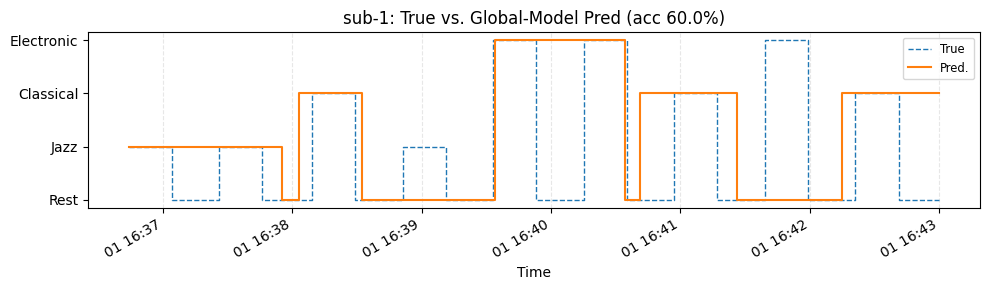

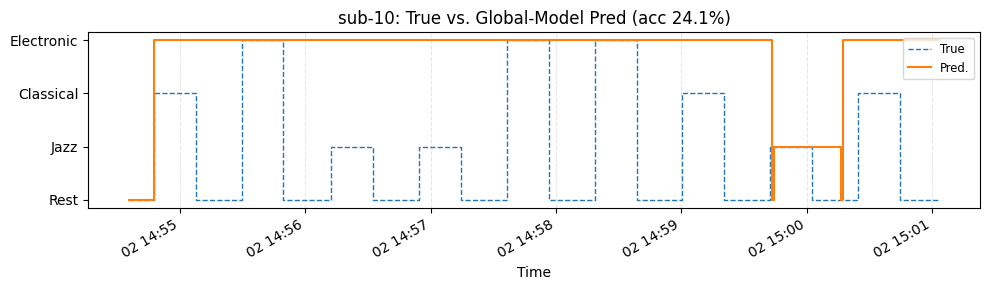

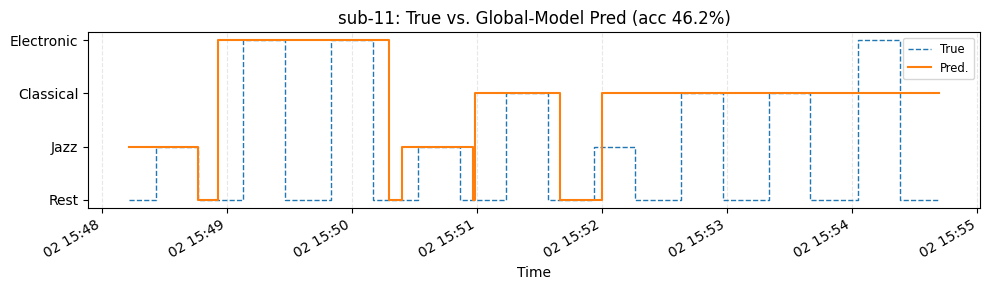

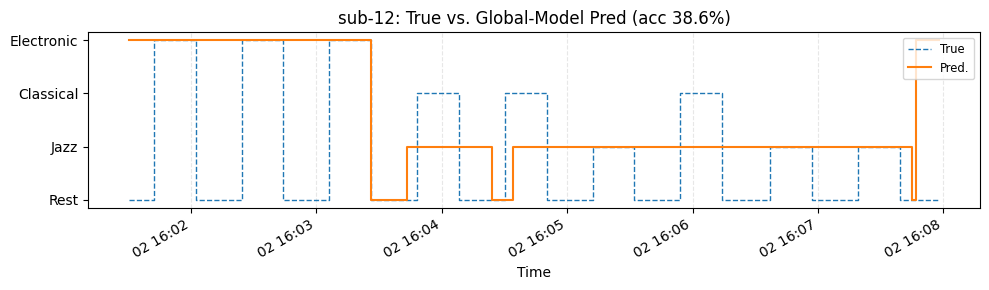

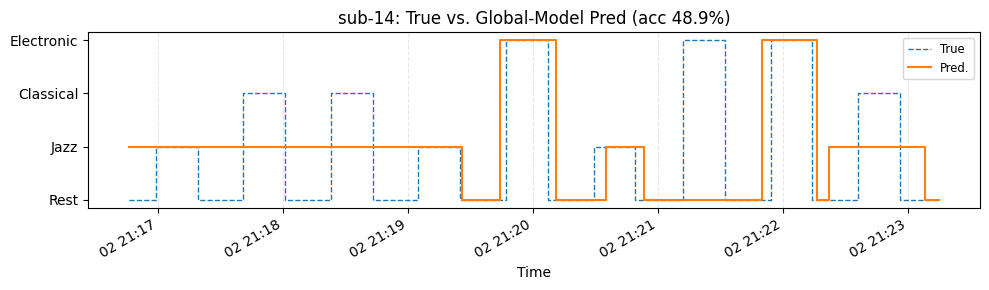

...

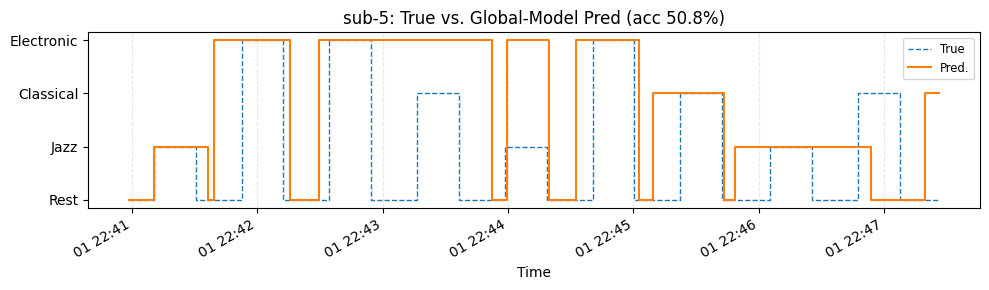

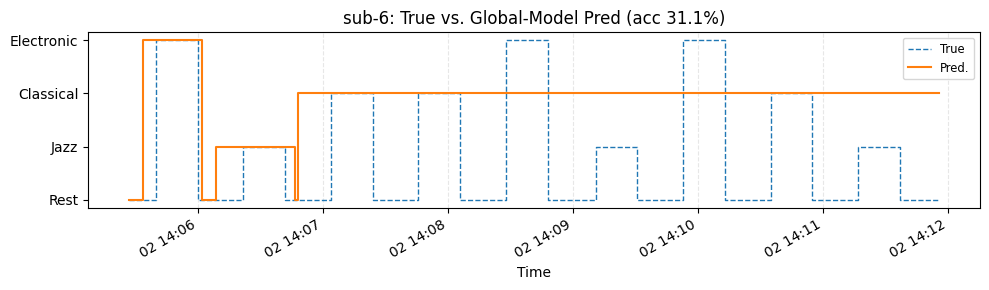

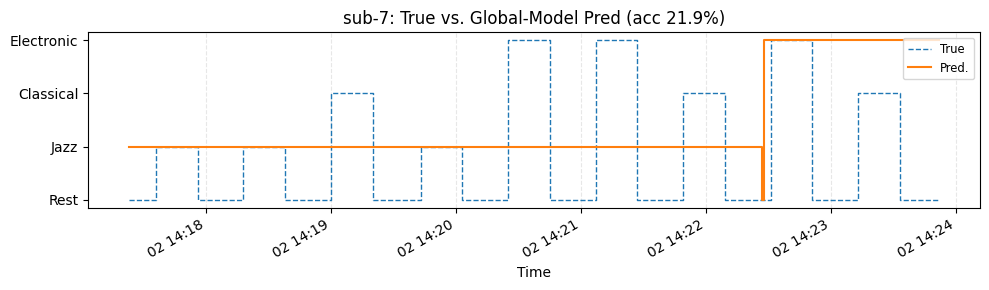

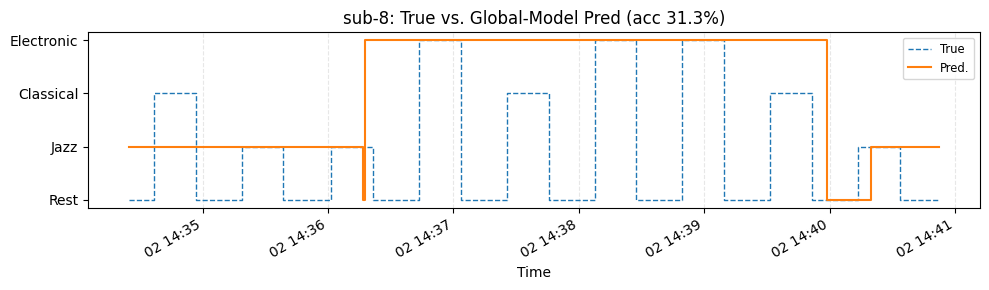

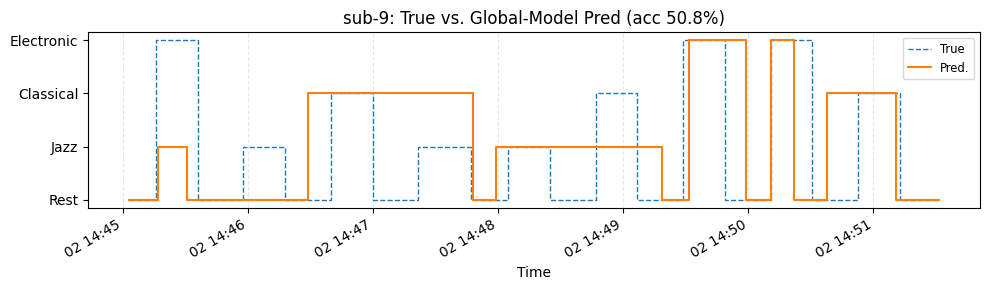

In [12]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from hmmlearn import hmm

# === User settings ===
root_dir = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_MGR"  # contains sub-1, sub-2, etc.
# List specific EEG feature columns to use, or leave empty to use all numeric columns:
selected_features = [
  "Delta_TP9", "Delta_AF7", "Delta_AF8", "Delta_TP10",
  "Theta_TP9", "Theta_AF7", "Theta_AF8", "Theta_TP10",
  "Alpha_TP9", "Alpha_AF7", "Alpha_AF8", "Alpha_TP10",
  "Beta_TP9",  "Beta_AF7",  "Beta_AF8",  "Beta_TP10",
  "Gamma_TP9", "Gamma_AF7", "Gamma_AF8", "Gamma_TP10"
]


# These are the four states we’ll classify:
all_states = ["Rest", "Jazz", "Classical", "Electronic"]
n_states   = len(all_states)
state2idx  = {s:i for i,s in enumerate(all_states)}
idx2state  = {i:s for s,i in state2idx.items()}

# Containers for global training
init_counts    = np.zeros(n_states)               # counts of which state subjects start in
trans_counts   = np.zeros((n_states, n_states))   # global transition counts
emission_data  = {s: [] for s in all_states}      # list of observations per state
subject_data   = {}                               # to store each subject's (X, y_idx, times)

# === PHASE 1: Collect data & accumulate statistics ===
for subj_dir in sorted(glob.glob(os.path.join(root_dir, "sub-*"))):
    subj_id = os.path.basename(subj_dir)
    # find files
    eeg_files = glob.glob(os.path.join(subj_dir, "*mindMonitor*.csv"))
    log_files = glob.glob(os.path.join(subj_dir, "*music_genre_experiment_log*.txt"))
    if not eeg_files or not log_files:
        print(f"{subj_id}: missing data, skipping")
        continue
    eeg_file, log_file = eeg_files[0], log_files[0]

    # 1) load & clean EEG
    df = pd.read_csv(eeg_file)
    if "Elements" in df.columns:
        df = df[df["Elements"].isna()]
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # 2) parse log and build intervals
    sync_df = pd.read_csv(log_file, sep="\t", header=None, names=["Event","Time"])
    sync_df.dropna(inplace=True)
    exp0 = float(sync_df.loc[sync_df["Event"].str.contains("Experiment Unix Start"), "Time"].iat[0])
    t0   = exp0 + 2*3600
    to_ts = lambda offs: pd.to_datetime(t0 + float(offs), unit="s")

    intervals = {s: [] for s in all_states}
    # baseline → Rest
    b0 = sync_df.loc[sync_df["Event"]=="Baseline Start", "Time"].iat[0]
    b1 = sync_df.loc[sync_df["Event"]=="Baseline End",   "Time"].iat[0]
    intervals["Rest"].append((to_ts(b0), to_ts(b1)))
    # music & post-rest
    for i,row in sync_df.iterrows():
        ev, offs = row["Event"], row["Time"]
        if ev.startswith("Music Start"):
            genre = ev.split(" - ")[2]
            start = to_ts(offs)
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals[genre].append((start, end))
        elif ev.startswith("Post Rest Start"):
            start = to_ts(offs)
            end   = to_ts(sync_df.at[i+1, "Time"])
            intervals["Rest"].append((start, end))

    # 3) label each sample
    df["Condition"] = "Unlabeled"
    for cond, spans in intervals.items():
        for start,end in spans:
            df.loc[(df.index>=start)&(df.index<=end),"Condition"] = cond
    df = df[df["Condition"]!="Unlabeled"]

    # 4) select features
    if selected_features:
        missing = set(selected_features) - set(df.columns)
        if missing:
            print(f"{subj_id}: warning, missing {missing}")
        feature_cols = [c for c in selected_features if c in df.columns]
    else:
        feature_cols = df.select_dtypes(include=[np.number]).columns.tolist()

    X      = df[feature_cols].T.values      # (n_features, n_timesteps)
    conds  = df["Condition"].values
    times  = df.index.to_numpy()

    # convert conds to indices
    y_idx = np.array([state2idx[c] for c in conds])

    # accumulate init count
    init_counts[y_idx[0]] += 1

    # accumulate transitions
    for a,b in zip(y_idx[:-1], y_idx[1:]):
        trans_counts[a,b] += 1

    # collect emissions
    for i in range(n_states):
        mask = (y_idx == i)
        if mask.any():
            emission_data[ idx2state[i] ].append( X[:,mask].T )

    # store for later evaluation
    subject_data[subj_id] = (X, y_idx, times)

# build global pi
pi = init_counts / init_counts.sum()

# build global A
A = (trans_counts.T / trans_counts.sum(axis=1)).T
for i in range(n_states):
    if A[i].sum()==0:
        A[i,i] = 1.0

# build global emission Gaussians
means, covars = [], []
reg = 1e-2
for state in all_states:
    # concatenate all obs for this state
    data = np.vstack(emission_data[state])  # shape (total_samples, n_features)
    mu = data.mean(axis=0)
    C  = np.cov(data, rowvar=False)
    C  = 0.5*(C + C.T) + reg*np.eye(C.shape[1])
    means.append(mu)
    covars.append(C)
means  = np.vstack(means)
covars = np.stack(covars)

# build the global HMM
model = hmm.GaussianHMM(n_components=n_states,
                        covariance_type="full",
                        init_params="")
model.startprob_ = pi
model.transmat_  = A
model.means_     = means
model.covars_    = covars

# === PHASE 2: Apply to each subject & report ===
for subj_id, (X, y_idx_true, times) in subject_data.items():
    # decode
    _, y_pred_idx = model.decode(X.T, algorithm="viterbi")
    acc = (y_pred_idx == y_idx_true).mean()
    print(f"{subj_id}: global‐model accuracy = {acc*100:.2f}%")

    # plot true vs predicted
    fig, ax = plt.subplots(figsize=(10,3))
    ax.step(times, y_idx_true, where="post", linestyle="--", label="True",   lw=1)
    ax.step(times, y_pred_idx, where="post", linestyle="-",  label="Pred.",   lw=1.5)
    ax.set_yticks(range(n_states)); ax.set_yticklabels(all_states)
    ax.set_title(f"{subj_id}: True vs. Global‐Model Pred (acc {acc*100:.1f}%)")
    ax.set_xlabel("Time"); ax.grid(axis="x", linestyle="--", alpha=0.3)
    ax.legend(loc="upper right", fontsize="small")
    fig.autofmt_xdate()
    plt.tight_layout()

plt.show()


# baseline correction for each band (single subject), corrected by averaged band 1 s before each task onset

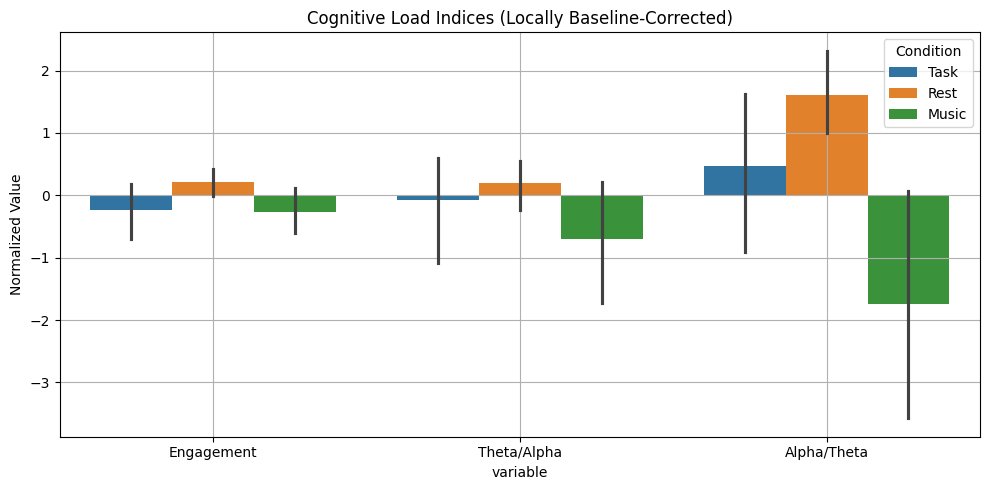

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# Load EEG data
#eeg_file = "C:/Users/Jiahui An/Geo/CC_project/Data/sub-10/mindMonitor_2025-04-30--14-23-31_10.csv"
df = pd.read_csv(eeg_file)
df["Time"] = pd.to_datetime(df["TimeStamp"])
df.set_index("Time", inplace=True)

# Load log file
#log_file = "C:/Users/Jiahui An/Geo/CC_project/Data/sub-10/eeg_experiment_timeline_log_10.txt"
sync_df = pd.read_csv(log_file, sep='\t', header=None, names=["Event", "Time"]).dropna()

# Extract start time
start_unix = float(sync_df[sync_df["Event"].str.contains("Experiment Unix Start")]["Time"].values[0]) + 2*3600

# Define bands and channels
bands = ["Delta", "Theta", "Alpha", "Beta"]
channels = ["TP9", "AF7", "AF8", "TP10"]
band_cols = [f"{band}_{ch}" for band in bands for ch in channels if f"{band}_{ch}" in df.columns]

# Compute average band power per band
df_band_avg = pd.DataFrame(index=df.index)
for band in bands:
    cols = [f"{band}_{ch}" for ch in channels if f"{band}_{ch}" in df.columns]
    df_band_avg[band] = df[cols].mean(axis=1)

# === Segment labeling and local baseline correction ===
segments = []
baseline_window_sec = 1  # 1 second before segment start

for i in range(len(sync_df) - 1):
    event = sync_df.iloc[i]["Event"]
    t0 = pd.to_datetime(start_unix + sync_df.iloc[i]["Time"], unit="s")
    t1 = pd.to_datetime(start_unix + sync_df.iloc[i + 1]["Time"], unit="s")

    if any(x in event for x in ["Task Start", "Rest Start", "Music Start", "Post-Rest Start"]):
        label = (
            "Task" if "Task" in event else
            "Rest" if "Rest Start" in event and "Post" not in event else
            "Post-Rest" if "Post-Rest" in event else
            "Music"
        )

        # Define segment and local baseline window
        segment_data = df_band_avg.loc[(df_band_avg.index >= t0) & (df_band_avg.index < t1)].copy()
        baseline_data = df_band_avg.loc[(df_band_avg.index >= t0 - pd.Timedelta(seconds=baseline_window_sec)) & (df_band_avg.index < t0)]

        # Compute local baseline mean per band
        baseline_mean = baseline_data.mean()

        # Subtract baseline
        corrected = segment_data[bands] - baseline_mean

        # Add features
        corrected["Engagement"] = corrected["Beta"] / (corrected["Alpha"] + corrected["Theta"] + 1e-6)
        corrected["Theta/Alpha"] = corrected["Theta"] / (corrected["Alpha"] + 1e-6)
        corrected["Alpha/Theta"] = corrected["Alpha"] / (corrected["Theta"] + 1e-6)

        # Add condition label
        corrected["Condition"] = label

        segments.append(corrected)

# Combine all labeled segments
df_all = pd.concat(segments)

# Optional plot
import seaborn as sns
plt.figure(figsize=(10,5))
sns.barplot(
    data=df_all.melt(id_vars="Condition", value_vars=["Engagement", "Theta/Alpha", "Alpha/Theta"]),
    x="variable", y="value", hue="Condition"
)
plt.title("Cognitive Load Indices (Locally Baseline-Corrected)")
plt.ylabel("Normalized Value")
plt.grid(True)
plt.tight_layout()
plt.show()


In [14]:
print("\nCondition counts:")
print(df_all["Condition"].value_counts())
# Label baseline segment
baseline_start = pd.to_datetime(start_unix + sync_df[sync_df["Event"] == "Baseline Start"]["Time"].values[0], unit="s")
baseline_end = pd.to_datetime(start_unix + sync_df[sync_df["Event"] == "Baseline End"]["Time"].values[0], unit="s")
baseline_data = df_band_avg.loc[(df_band_avg.index >= baseline_start) & (df_band_avg.index < baseline_end)].copy()

# Baseline correction (from 1s before baseline start)
baseline_window = df_band_avg.loc[(df_band_avg.index >= baseline_start - pd.Timedelta(seconds=1)) & (df_band_avg.index < baseline_start)]
baseline_mean = baseline_window.mean()
corrected_baseline = baseline_data[bands] - baseline_mean

corrected_baseline["Engagement"] = corrected_baseline["Beta"] / (corrected_baseline["Alpha"] + corrected_baseline["Theta"] + 1e-6)
corrected_baseline["Theta/Alpha"] = corrected_baseline["Theta"] / (corrected_baseline["Alpha"] + 1e-6)
corrected_baseline["Alpha/Theta"] = corrected_baseline["Alpha"] / (corrected_baseline["Theta"] + 1e-6)
corrected_baseline["Condition"] = "Baseline"

segments.append(corrected_baseline)




Condition counts:
Condition
Rest     656
Task     652
Music    458
Name: count, dtype: int64


# statistical comparison between each condition for each features

In [15]:
from scipy.stats import ttest_ind

# Features to compare
features = ["Engagement", "Theta/Alpha", "Alpha/Theta"]

# Prepare groups
group_task = df_all[df_all["Condition"] == "Task"]
group_rest = df_all[df_all["Condition"] == "Rest"]
group_music = df_all[df_all["Condition"] == "Music"]

print("=== Statistical Comparison ===\n")

# Compare Task vs. Rest
print("Task vs. Rest")
for feat in features:
    t, p = ttest_ind(group_task[feat], group_rest[feat], equal_var=False, nan_policy="omit")
    print(f"{feat:<12}: t = {t:8.4f}, p = {p:8.4f}")
print("\n")

# Compare Music vs. Rest
print("Music vs. Rest")
for feat in features:
    t, p = ttest_ind(group_music[feat], group_rest[feat], equal_var=False, nan_policy="omit")
    print(f"{feat:<12}: t = {t:8.4f}, p = {p:8.4f}")


=== Statistical Comparison ===

Task vs. Rest
Engagement  : t =  -1.7070, p =   0.0889
Theta/Alpha : t =  -0.6104, p =   0.5421
Alpha/Theta : t =  -1.5486, p =   0.1225


Music vs. Rest
Engagement  : t =  -2.1072, p =   0.0361
Theta/Alpha : t =  -1.6798, p =   0.0946
Alpha/Theta : t =  -3.5080, p =   0.0006


## using absolute values of the band power, baseline corrected (- averaged rest condition), plus statistical analysis

to do: consider transient effect, explore the optimal task duration and rest duration for averaging

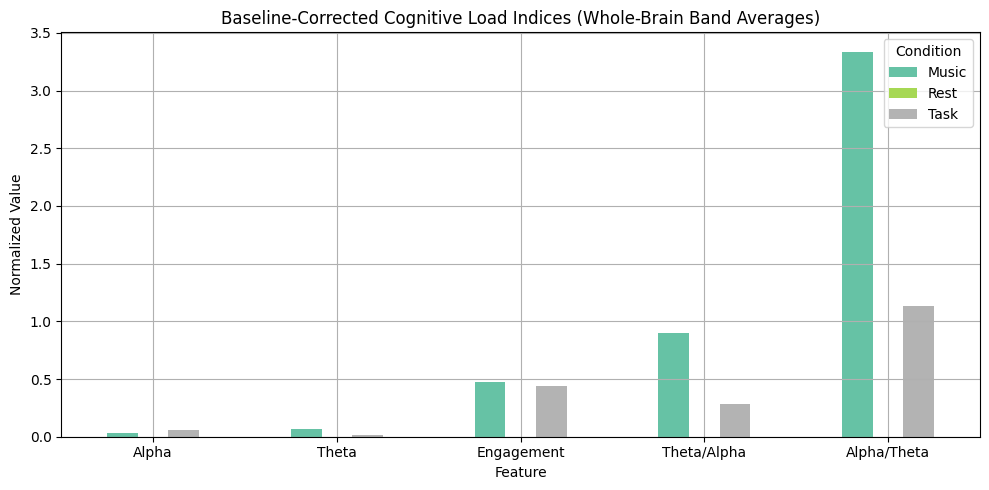

=== Task vs. Rest Statistical Comparison ===
    Feature  t-value  p-value
      Alpha 2.276652 0.023415
      Theta 1.055304 0.291930
 Engagement 1.192667 0.234019
Theta/Alpha 1.167346 0.244113
Alpha/Theta 0.742332 0.458520


In [16]:
#we took the absolute values
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load pre-processed EEG band power data with condition labels
file_path = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/features.csv"
df = pd.read_csv(file_path, parse_dates=["Time"])
df.set_index("Time", inplace=True)

# Define features based on whole-brain average bands (per row)
eps = 1e-6
df["Engagement"] = df["Beta"] / (df["Alpha"] + df["Theta"] + eps)
df["Theta/Alpha"] = df["Theta"] / (df["Alpha"] + eps)
df["Alpha/Theta"] = df["Alpha"] / (df["Theta"] + eps)

# Aggregate per condition
features = ["Alpha", "Theta","Engagement", "Theta/Alpha", "Alpha/Theta"]
condition_avg = df.groupby("Condition")[features].mean()

# Baseline correction
baseline_mean = condition_avg.loc["Rest"]
condition_corrected = condition_avg - baseline_mean

# Normalize (absolute values)
condition_corrected_normalized = condition_corrected.abs()

# Plot the normalized values
condition_corrected_normalized.T.plot(kind="bar", figsize=(10, 5), colormap="Set2")
plt.title("Baseline-Corrected Cognitive Load Indices (Whole-Brain Band Averages)")
plt.ylabel("Normalized Value")
plt.xlabel("Feature")
plt.xticks(rotation=0)
plt.grid(True)
plt.tight_layout()
plt.show()

from scipy.stats import ttest_ind

# Drop baseline and keep only Task and Rest
df = df[df["Condition"].isin(["Task", "Rest"])].copy()

# Recompute features after baseline correction per row
df["Engagement"] = df["Beta"] / (df["Alpha"] + df["Theta"] + eps)
df["Theta/Alpha"] = df["Theta"] / (df["Alpha"] + eps)
df["Alpha/Theta"] = df["Alpha"] / (df["Theta"] + eps)

# Apply baseline correction: subtract per-feature baseline mean
for f in features:
    df[f] = df[f] - baseline_mean[f]

# Take absolute values (normalize)
df[features] = df[features].abs()

# Run t-tests
results = []
for f in features:
    task_vals = df[df["Condition"] == "Task"][f].dropna()
    rest_vals = df[df["Condition"] == "Rest"][f].dropna()
    t_stat, p_val = ttest_ind(task_vals, rest_vals, equal_var=False)
    results.append({"Feature": f, "t-value": t_stat, "p-value": p_val})

# Display as DataFrame
results_df = pd.DataFrame(results)
print("=== Task vs. Rest Statistical Comparison ===")
print(results_df.to_string(index=False))


## generating labeled data for each participant

In [18]:
import os
import pandas as pd
import numpy as np

# === Setup ===
base_path = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all"
bands = ["Delta", "Theta", "Alpha", "Beta"]
channels = ["TP9", "AF7", "AF8", "TP10"]

# === Loop through all subject folders ===
for subfolder in sorted(os.listdir(base_path)):
    sub_path = os.path.join(base_path, subfolder)
    if not os.path.isdir(sub_path):
        continue

    print(f"\nProcessing {subfolder}...")

    # Find EEG and log file
    eeg_file = next((f for f in os.listdir(sub_path) if f.endswith(".csv")), None)
    log_file = next((f for f in os.listdir(sub_path) if f.endswith(".txt")), None)
    if eeg_file is None or log_file is None:
        print(f"Missing EEG or log file in {subfolder}")
        continue

    # === Load EEG ===
    df = pd.read_csv(os.path.join(sub_path, eeg_file))
    df["Time"] = pd.to_datetime(df["TimeStamp"])
    df.set_index("Time", inplace=True)

    # === Load Log ===
    log_df = pd.read_csv(os.path.join(sub_path, log_file), sep="\t", header=None, names=["Event", "Time"]).dropna()

    # === Extract and correct experiment start time ===
    try:
        start_unix = float(log_df[log_df["Event"].str.contains("Experiment Unix Start")]["Time"].values[0]) + 2 * 3600
    except Exception as e:
        print(f"Could not extract start time in {subfolder}: {e}")
        continue

    # === Compute average band power per band ===
    df_band_avg = pd.DataFrame(index=df.index)
    for band in bands:
        cols = [f"{band}_{ch}" for ch in channels if f"{band}_{ch}" in df.columns]
        df_band_avg[band] = df[cols].mean(axis=1)

    # === Segment labeling and local baseline correction ===
    segments = []
    baseline_window_sec = 1  # 1 second before segment start

    for i in range(len(log_df) - 1):
        event = log_df.iloc[i]["Event"]
        t0 = pd.to_datetime(start_unix + log_df.iloc[i]["Time"], unit="s")
        t1 = pd.to_datetime(start_unix + log_df.iloc[i + 1]["Time"], unit="s")

        if any(x in event for x in ["Task Start", "Rest Start", "Music Start", "Post-Rest Start"]):
            label = (
                "Task" if "Task" in event else
                "Rest" if "Rest Start" in event and "Post" not in event else
                "Post-Rest" if "Post-Rest" in event else
                "Music"
            )

            segment_data = df_band_avg.loc[(df_band_avg.index >= t0) & (df_band_avg.index < t1)].copy()
            baseline_data = df_band_avg.loc[(df_band_avg.index >= t0 - pd.Timedelta(seconds=baseline_window_sec)) & (df_band_avg.index < t0)]

            if baseline_data.empty or segment_data.empty:
                continue

            baseline_mean = baseline_data.mean()
            corrected = segment_data[bands] - baseline_mean

            corrected["Engagement"] = corrected["Beta"] / (corrected["Alpha"] + corrected["Theta"] + 1e-6)
            corrected["Theta/Alpha"] = corrected["Theta"] / (corrected["Alpha"] + 1e-6)
            corrected["Alpha/Theta"] = corrected["Alpha"] / (corrected["Theta"] + 1e-6)
            corrected["Condition"] = label

            segments.append(corrected)

    if not segments:
        print(f"No valid segments found in {subfolder}.")
        continue

    df_all = pd.concat(segments)
    out_csv = os.path.join(sub_path, "features.csv")
    df_all.to_csv(out_csv)
    print(f"Saved features to: {out_csv}")



Processing sub-1...


KeyError: 'TimeStamp'

## group level statistical analysis

In [19]:
import os
import pandas as pd
import numpy as np
from scipy.stats import ttest_ind

# === Setup ===
base_path = "/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all"
features_to_compare = ["Engagement", "Theta/Alpha", "Alpha/Theta", "Theta", "Alpha"]
all_data = []

# === Load all features.csv files ===
for subfolder in sorted(os.listdir(base_path)):
    file_path = os.path.join(base_path, subfolder, "features.csv")
    if os.path.exists(file_path):
        df = pd.read_csv(file_path, parse_dates=["Time"])
        df["Participant"] = subfolder
        all_data.append(df)

# Combine all participants
df_all = pd.concat(all_data, ignore_index=True)

# === Summary counts ===
print("Condition counts:")
print(df_all["Condition"].value_counts())
print()

# === Perform t-tests on absolute values ===
comparisons = [("Task", "Rest"), ("Music", "Rest")]
results = []

for cond1, cond2 in comparisons:
    for feat in features_to_compare:
        data1 = df_all[df_all["Condition"] == cond1][feat].dropna().abs()
        data2 = df_all[df_all["Condition"] == cond2][feat].dropna().abs()
        t_stat, p_val = ttest_ind(data1, data2, equal_var=False)
        results.append({
            "Comparison": f"{cond1} vs. {cond2}",
            "Feature": feat,
            "t-value": round(t_stat, 4),
            "p-value": round(p_val, 4)
        })

# Convert to DataFrame
results_df = pd.DataFrame(results)

# === Display ===
print("=== Statistical Comparison Across All Participants (Absolute Values) ===")
print(results_df)

# Save results
results_df.to_csv(os.path.join(base_path, "group_comparison_results_abs.csv"), index=False)


Condition counts:
Condition
Task     3382
Rest     3297
Music    2482
Name: count, dtype: int64

=== Statistical Comparison Across All Participants (Absolute Values) ===
       Comparison      Feature  t-value  p-value
0   Task vs. Rest   Engagement   0.9057   0.3652
1   Task vs. Rest  Theta/Alpha  -1.9256   0.0543
2   Task vs. Rest  Alpha/Theta  -0.3553   0.7224
3   Task vs. Rest        Theta   4.0210   0.0001
4   Task vs. Rest        Alpha   1.9044   0.0569
5  Music vs. Rest   Engagement   0.8337   0.4046
6  Music vs. Rest  Theta/Alpha  -2.1283   0.0334
7  Music vs. Rest  Alpha/Theta  -1.7361   0.0826
8  Music vs. Rest        Theta  10.0026   0.0000
9  Music vs. Rest        Alpha   9.7484   0.0000


## training binary classifier based on selected features: mlp, svm, snn...

Fitting 5 folds for each of 648 candidates, totalling 3240 fits


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   3.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   5.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, ba

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   3.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   6.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   3.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   3.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   4.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   5.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   6.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   6.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   7.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   6.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   3.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=relu, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   3.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   8.0s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   8.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   3.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.0s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   6.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   6.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.6s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   8.5s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   8.9s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   3.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   9.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   9.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.9s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.0001, batch_s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  12.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, b

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=relu, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.5s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.8s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.0s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.7s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.000

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, al

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activ

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=  19.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=  19.7s
[CV] END activation=relu, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=  19.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   3.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   3.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   3.1s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.3s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   4.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   4.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   5.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   6.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   6.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   7.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   4.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   5.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   7.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   7.8s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   6.5s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.7s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   8.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  10.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  10.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.6s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alph

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.8s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.9s
[CV] END activation=relu, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=relu, alpha=0.001, ba

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, bat

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alp

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, h

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_siz

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.3s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   4.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.1s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.5s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.2s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=5

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_lay

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hid

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.01, ba

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.0s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, al

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=relu

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   3.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   3.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   3.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   3.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   3.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   5.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   7.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   7.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   4.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=tanh, alpha=0.0001, b

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   4.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   5.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=  10.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   8.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   3.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   7.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   7.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   8.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   9.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=  10.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=  10.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=  15.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  11.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   4.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Op

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Op

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  14.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  14.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=  14.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=  20.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=  13.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=  12.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  17.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=  17.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   3.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   5.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=t

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activa

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Op

[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=tanh, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidde

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   3.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   3.7s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   3.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   4.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.1s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   3.4s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   4.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   4.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   4.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   4.9s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   5.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   6.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   6.2s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   6.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=  10.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.1s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.8s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   6.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   5.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   6.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.9s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Op

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   8.8s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.00

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.2s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   4.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alp

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.9s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.6s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batc

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.0s
[CV] END activation=tanh, alpha=0.001, batch_s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   4.9s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tan

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=tanh, a

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Op

[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=tanh, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.9s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   2.9s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   4.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   3.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.3s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.9s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5,

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidde

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   1.9s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   2.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=tanh, alpha=0.01, bat

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.7s
[CV] END activation=tanh, alpha=0.01, b

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_siz

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=1

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   4.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.0s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.4s
[CV] END activation=ta

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


[CV] END activation=tanh, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   2.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   3.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   3.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   3.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   4.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   2.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   3.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   3.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   3.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   3.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   3.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   4.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   7.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   3.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   3.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=l

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   6.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   4.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] E

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.4s[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.5s

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.7s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END ac

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=  

sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret 

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=  

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; tot

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/s

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.0001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   2.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END ac

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   2.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   2.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   1.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.6s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   2.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   3.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   1.6s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   2.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   2.8s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activati

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.9s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=lo

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activat

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=l

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activatio

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV]

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time= 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[C

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.0s
[CV] E

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV]

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activat

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.0s

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total t

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time= 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.001, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] E

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.1s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   1.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   2.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   2.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   1.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.9s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.0s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   1.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.3s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   1.6s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   1.9s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   2.8s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.0s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   3.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   1.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logist

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.8s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alp

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   1.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=1, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   2.0s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logis

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.4s
[CV] END activati

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=adam; total time=   0.

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.3s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.7s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.2s
[CV] END

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=5, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.3s
[CV] END activati

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.5s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activ

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50,), learning_rate_init=0.001, solver=sgd; total time=   0.6s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.001, solver=sgd; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.01, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100,), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.01, solver=adam; total time=   0.2s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] 

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(50, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.01, solver=sgd; total time=   0.0s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=

/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=sgd; total time=   0.1s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.001, solver=adam; total time=   0.4s
[CV] END activation=logistic, alpha=0.01, batch_size=16, hidden_layer_sizes=(100, 50), learning_rate_init=0.1, solver=adam; total time=   0.2s


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


Best MLP Parameters: {'activation': 'tanh', 'alpha': 0.0001, 'batch_size': 5, 'hidden_layer_sizes': (100, 50), 'learning_rate_init': 0.001, 'solver': 'adam'}


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  re


 Cross-Validated Performance:
Accuracy: 0.758 ± 0.029
Precision: 0.812 ± 0.021
Recall: 0.670 ± 0.064
F1: 0.733 ± 0.043


/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/.venv/lib/python3.9/site-packages/

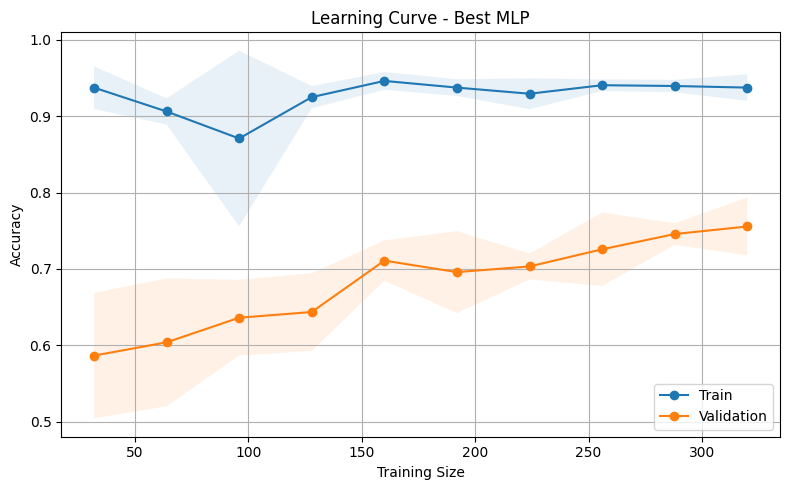

In [20]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, GridSearchCV, learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt

# === Load Combined Features ===
df = pd.read_csv("/Users/kyrusmama/Downloads/ref_prep_synchr_MAT_jiahui/Data_all/sub-10/features.csv")#only contain labeled data for sub-10
df = df[df["Condition"].isin(["Task", "Rest"])]  # binary classification only

# === Define Features & Labels ===
features = ["Engagement",  "Alpha/Theta", "Theta/Alpha",  "Theta", "Alpha"]

# Drop rows with missing features
df = df.dropna(subset=features)

X = df[features].values
y = df["Condition"].map({"Task": 1, "Rest": 0}).values

# === Normalize ===
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# === Grid Search for MLP ===
param_grid = {
    "hidden_layer_sizes": [(50,), (100,), (50, 50), (100, 50)],
    "activation": ["relu", "tanh", "logistic"],
    "alpha": [0.0001, 0.001, 0.01],
    "learning_rate_init": [0.001, 0.01, 0.1],
    "batch_size": [1, 5, 16],
    "solver": ["adam", "sgd"],
}

mlp = MLPClassifier(max_iter=500, random_state=42)
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search = GridSearchCV(mlp, param_grid, scoring="accuracy", cv=cv, n_jobs=-1, verbose=2)
grid_search.fit(X_scaled, y)

best_model = grid_search.best_estimator_
print("Best MLP Parameters:", grid_search.best_params_)

# === Evaluate with Cross-Validation ===
metrics = {"accuracy": [], "precision": [], "recall": [], "f1": []}

for train_idx, test_idx in cv.split(X_scaled, y):
    X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
    y_train, y_test = y[train_idx], y[test_idx]

    best_model.fit(X_train, y_train)
    y_pred = best_model.predict(X_test)

    metrics["accuracy"].append(accuracy_score(y_test, y_pred))
    metrics["precision"].append(precision_score(y_test, y_pred))
    metrics["recall"].append(recall_score(y_test, y_pred))
    metrics["f1"].append(f1_score(y_test, y_pred))

# Print mean ± std
print("\n Cross-Validated Performance:")
for m, scores in metrics.items():
    print(f"{m.capitalize()}: {np.mean(scores):.3f} ± {np.std(scores):.3f}")

# === Learning Curve Plot ===
train_sizes, train_scores, test_scores = learning_curve(
    best_model, X_scaled, y, cv=cv, scoring='accuracy',
    train_sizes=np.linspace(0.1, 1.0, 10), n_jobs=-1, shuffle=True, random_state=42
)

plt.figure(figsize=(8, 5))
plt.title("Learning Curve - Best MLP")
plt.plot(train_sizes, train_scores.mean(axis=1), 'o-', label="Train")
plt.plot(train_sizes, test_scores.mean(axis=1), 'o-', label="Validation")
plt.fill_between(train_sizes, train_scores.mean(axis=1) - train_scores.std(axis=1),
                 train_scores.mean(axis=1) + train_scores.std(axis=1), alpha=0.1)
plt.fill_between(train_sizes, test_scores.mean(axis=1) - test_scores.std(axis=1),
                 test_scores.mean(axis=1) + test_scores.std(axis=1), alpha=0.1)
plt.xlabel("Training Size")
plt.ylabel("Accuracy")
plt.grid(True)
plt.legend(loc="best")
plt.tight_layout()
plt.show()


In [ ]:
#combine all participants' features.csv files into one
# Base folder where all participant folders are stored
import pandas as pd
import os
all_dfs = []

for folder in sorted(os.listdir(base_path)):
    sub_path = os.path.join(base_path, folder)
    feature_file = os.path.join(sub_path, "features.csv")
    
    if os.path.exists(feature_file):
        try:
            df = pd.read_csv(feature_file)
            df["Participant"] = folder  # add ID
            all_dfs.append(df)
        except Exception as e:
            print(f"Error reading {feature_file}: {e}")

# Combine all
if all_dfs:
    df_all = pd.concat(all_dfs, ignore_index=True)
    output_path = os.path.join(base_path, "all_participants_features.csv")
    df_all.to_csv(output_path, index=False)
    print(f" Combined CSV saved to: {output_path}")
else:
    print(" No features.csv found in any subfolder.")


 Combined CSV saved to: /Users/jiahui/Downloads/dynap-se1-main/CC_project/Data_all/all_participants_features.csv



**SVM (linear kernel)**
Best Parameters: {'C': 10}
Accuracy: 0.534 ± 0.067
Precision: 0.544 ± 0.084
Recall: 0.533 ± 0.067
F1: 0.508 ± 0.069


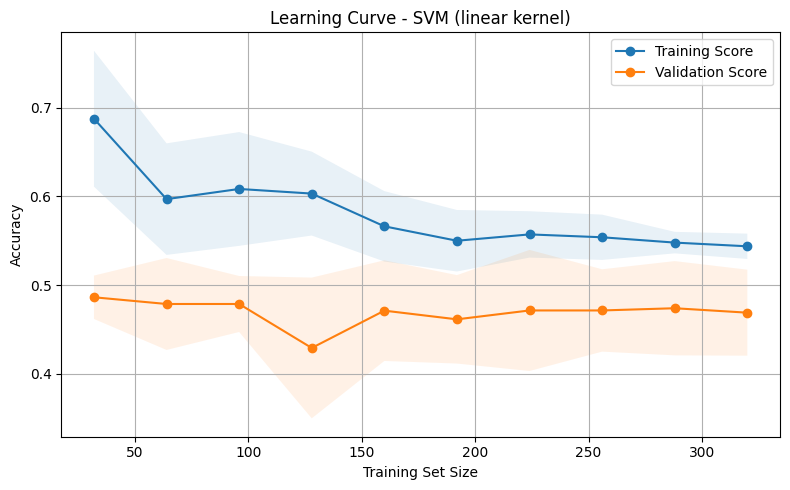


**SVM (poly kernel)**
Best Parameters: {'C': 200, 'coef0': 1.0, 'degree': 4}
Accuracy: 0.644 ± 0.054
Precision: 0.652 ± 0.055
Recall: 0.644 ± 0.054
F1: 0.639 ± 0.055


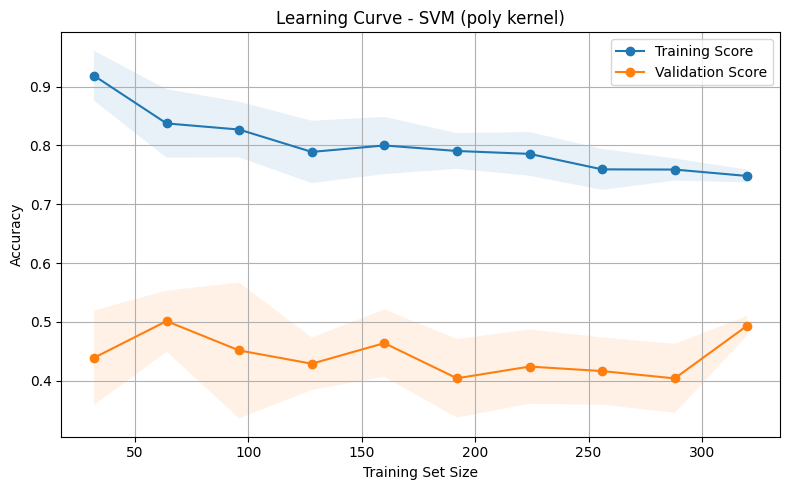


**SVM (rbf kernel)**
Best Parameters: {'C': 100, 'gamma': 1}
Accuracy: 0.688 ± 0.045
Precision: 0.694 ± 0.048
Recall: 0.688 ± 0.045
F1: 0.686 ± 0.045


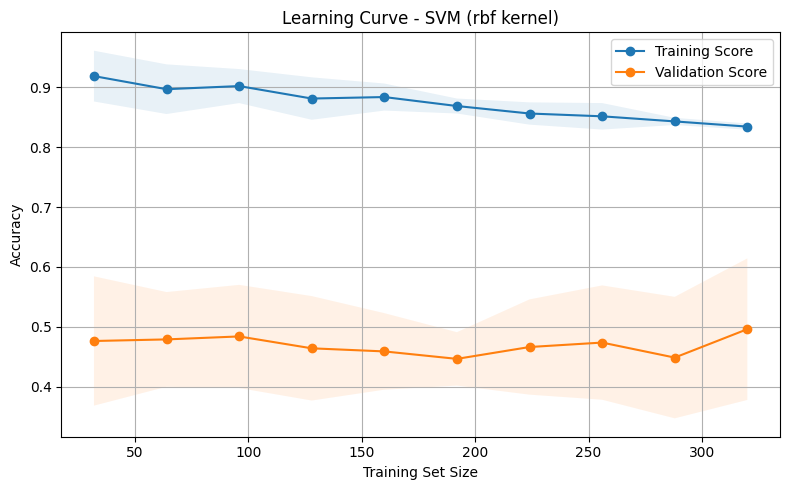

In [ ]:
#only with sub-10 as example
import numpy as np
import pandas as pd
from sklearn.model_selection import StratifiedKFold, GridSearchCV, learning_curve
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt

# -------------------------------

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# -------------------------------
# SVM Training & Evaluation
# -------------------------------
def tune_and_evaluate_svm(X, y, kernel):
    # Define parameter grid
    if kernel == "linear":
        param_grid = {'C': [0.01, 0.1, 1, 10, 20,50,100]}
    elif kernel == "poly":
        param_grid = {'C': [0.01, 0.1, 1, 10,100,200,500], 'degree': [2, 3, 4,5,6], 'coef0': [0.0, 0.5, 1.0]}
    elif kernel == "rbf":
        param_grid = {'C': [0.01, 0.1, 1, 10,100,200,500], 'gamma': ['scale', 'auto', 0.01, 0.1, 1]}

    model = SVC(kernel=kernel, probability=True, random_state=42)
    grid_search = GridSearchCV(model, param_grid, scoring='accuracy',
                               cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42),
                               n_jobs=-1)

    grid_search.fit(X, y)
    best_model = grid_search.best_estimator_
    best_params = grid_search.best_params_

    # Cross-validated metrics
    metrics = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}
    kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    for train_idx, test_idx in kf.split(X, y):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        best_model.fit(X_train, y_train)
        y_pred = best_model.predict(X_test)

        metrics['accuracy'].append(accuracy_score(y_test, y_pred))
        metrics['precision'].append(precision_score(y_test, y_pred, average="macro", zero_division=1))
        metrics['recall'].append(recall_score(y_test, y_pred, average="macro", zero_division=1))
        metrics['f1'].append(f1_score(y_test, y_pred, average="macro", zero_division=1))

    final_metrics = {k: (np.mean(v), np.std(v)) for k, v in metrics.items()}
    return best_model, best_params, final_metrics

# -------------------------------
# Learning Curve Plotter
# -------------------------------
def plot_learning_curve(model, X, y, title):
    train_sizes, train_scores, test_scores = learning_curve(
        model, X, y, cv=5, scoring='accuracy', n_jobs=-1,
        train_sizes=np.linspace(0.1, 1.0, 10), shuffle=True, random_state=42
    )

    train_mean, train_std = train_scores.mean(axis=1), train_scores.std(axis=1)
    test_mean, test_std = test_scores.mean(axis=1), test_scores.std(axis=1)

    plt.figure(figsize=(8, 5))
    plt.title(title)
    plt.xlabel("Training Set Size")
    plt.ylabel("Accuracy")
    plt.grid(True)
    plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1)
    plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, alpha=0.1)
    plt.plot(train_sizes, train_mean, 'o-', label="Training Score")
    plt.plot(train_sizes, test_mean, 'o-', label="Validation Score")
    plt.legend(loc="best")
    plt.tight_layout()
    plt.show()

# -------------------------------
# Run for Each Kernel
# -------------------------------
for kernel in ["linear", "poly", "rbf"]:
    print(f"\n**SVM ({kernel} kernel)**")
    best_model, best_params, metrics = tune_and_evaluate_svm(X_scaled, y, kernel)
    print("Best Parameters:", best_params)
    for m, (mean, std) in metrics.items():
        print(f"{m.capitalize()}: {mean:.3f} ± {std:.3f}")
    plot_learning_curve(best_model, X_scaled, y, title=f"Learning Curve - SVM ({kernel} kernel)")
